In [1]:
import os, glob, csv, pickle

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import matplotlib as mpl

from scipy.stats import rankdata
from scipy.special import binom
from scipy.spatial.distance import sqeuclidean

plt.style.use('ggplot')

# path to functional loadings
path_to_actuals = r'/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA'
path_to_data    = '/Users/Guille/Dropbox/HighLevel-Data/'

# Type of Assets
sources_ = ['Load', 'Solar', 'Wind']

(105120, 9) (105120, 9) (210240, 8)
(730, 288) (657, 1) (73, 1)
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_South_Central.pkl
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_North_Central.pkl
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_West.pkl
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_Coast.pkl
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_East.pkl
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_Southern.pkl
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_Far_West.pkl
/Users/Guille/Desktop/extreme_scenarios/data/actuals/fPCA/Load/18hr_North.pkl
(216, 1) (216, 10) (657, 10) (73, 10)
(730, 288) (210240,)
(657, 216) (73, 216)
(657, 72) (73, 72)
(216,) (657, 216) (657, 72) (216, 1)


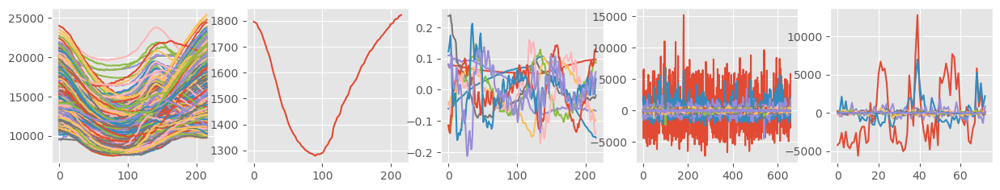

In [2]:
i_source = 0
i_asset  = 4
t_event = 18

# Define source and year source in {load, solar, wind} and year in {2017, 2018}
data_2017_ = pd.read_csv(path_to_data + sources_[i_source] + '_actual_5min_site_' + str(2017) + '.csv') 
data_2018_ = pd.read_csv(path_to_data + sources_[i_source] + '_actual_5min_site_' + str(2018) + '.csv') 
data_      = pd.concat([data_2017_, data_2018_]).drop(['Time'], axis = 1).to_numpy()
print(data_2017_.shape, data_2018_.shape, data_.shape)

path_to_fPCA = path_to_actuals + '/' + sources_[i_source] + '/' + str(t_event) + '*.pkl' 
files_       = glob.glob(path_to_fPCA)

t_, idx_tr_, idx_ts_ = pd.read_pickle(path_to_actuals + '/aux.pkl' )
idx_tr_ = np.array(idx_tr_)[:, np.newaxis] - 1
idx_ts_ = np.array(idx_ts_)[:, np.newaxis] - 1
print(t_.shape, idx_tr_.shape, idx_ts_.shape)

# Loop over found files in the directory
for file in files_: print(file)   

mu_tr_, Phi_tr_, Xi_tr_, Xi_ts_ = pd.read_pickle(files_[i_asset])
mu_tr_ = np.array(mu_tr_)[:, np.newaxis]
print(mu_tr_.shape, Phi_tr_.shape, Xi_tr_.shape, Xi_ts_.shape)

# X_ = t_.reshape(365*2, 12*24)
Y_ = np.concatenate([data_[i*12*24:(i + 1)*12*24, i_asset][:, np.newaxis] for i in range(365*2)], axis = 1).T
y_ = data_[:, i_asset]
print(Y_.shape, y_.shape)

Y_obs_tr_ = Y_[idx_tr_[:, 0], :t_event*12]
Y_obs_ts_ = Y_[idx_ts_[:, 0], :t_event*12]
Y_ac_tr_  = Y_[idx_tr_[:, 0], t_event*12:]
Y_ac_ts_  = Y_[idx_ts_[:, 0], t_event*12:]
print(Y_obs_tr_.shape, Y_obs_ts_.shape)
print(Y_ac_tr_.shape, Y_ac_ts_.shape)

N_obs  = Y_.shape[-1]
x_obs_ = np.linspace(0, N_obs - 1, N_obs)[:t_event*12]
x_ac_  = np.linspace(0, N_obs - 1, N_obs)[t_event*12:]
print(x_obs_.shape, Y_obs_tr_.shape, Y_ac_tr_.shape, mu_tr_.shape)

plt.figure(figsize = (15, 2.5))
plt.subplot(151)
plt.plot(x_obs_, Y_obs_tr_.T)
plt.subplot(152)
plt.plot(x_obs_, mu_tr_)
plt.subplot(153)
plt.plot(x_obs_, Phi_tr_)
plt.subplot(154)
plt.plot(Xi_tr_)
plt.subplot(155)
plt.plot(Xi_ts_)
plt.show()

87.23199867817756
427.4111002114871
(657, 657) (657, 72)


IndexError: index 80 is out of bounds for axis 1 with size 72

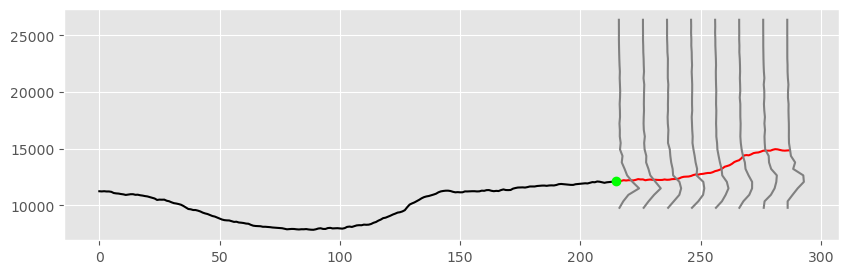

In [405]:
from scipy.spatial.distance import euclidean

def _exp_dist(X_, x_, sigma = 1.):
    N_samples = X_.shape[0]
    d_ = np.zeros((N_samples, 1))
    for i in range(N_samples):
        d_[i] = np.exp( - sigma*euclidean(X_[i, :], x_))
    print(d_.sum())
    return d_/d_.sum()


N_tr_days_ = idx_tr_.shape[0]
N_ts_days_ = idx_ts_.shape[0]

nu = 0.5

for i in range(N_ts_days_):

    xi_ts_    = Xi_ts_[i, :]
    y_obs_ts_ = Y_obs_ts_[i, :]
    y_ac_ts_  = Y_ac_ts_[i, :]

    #print(i, Xi_tr_.shape, xi_ts_.shape, Y_tr_.shape, y_ts_.shape)

    w_  = _exp_dist( Y_obs_tr_,  y_obs_ts_, sigma = 0.0001)
    fw_ = _exp_dist(Xi_tr_, xi_ts_, sigma = 0.0001)
    pi_ = (1. - nu)*w_ + fw_*nu
    #print(w_.shape, fw_.shape)

    y_ac_hat_ = Y_ac_tr_.T @ w_
    f_ac_hat_ = Y_ac_tr_.T @ fw_
    yf_ac_hat_ = Y_ac_tr_.T @ pi_
    y_ac_hat_ *= y_obs_ts_[-1]/y_ac_hat_[0]
    f_ac_hat_ *= y_obs_ts_[-1]/f_ac_hat_[0]
    yf_ac_hat_ *= y_obs_ts_[-1]/yf_ac_hat_[0]
    print((np.eye(w_.shape[0])*w_).shape, (Y_ac_tr_ - y_ac_hat_.T).shape)
    sy_ac_hat_ = 2.*np.sqrt(np.diag((Y_ac_tr_ - y_ac_hat_.T).T @ (np.eye(w_.shape[0])*w_) @ (Y_ac_tr_ - y_ac_hat_.T)))
    sf_ac_hat_ = 2.*np.sqrt(np.diag((Y_ac_tr_ - f_ac_hat_.T).T @ (np.eye(fw_.shape[0])*fw_) @ (Y_ac_tr_ - f_ac_hat_.T)))
    syf_ac_hat_ = 2.*np.sqrt(np.diag((Y_ac_tr_ - yf_ac_hat_.T).T @ (np.eye(pi_.shape[0])*pi_) @ (Y_ac_tr_ - yf_ac_hat_.T)))

    plt.figure(figsize = (10, 3))
    plt.plot(x_obs_, y_obs_ts_, 'k', label = 'f (obs)')
    plt.plot(x_ac_, y_ac_ts_, 'r', label = 'f (ac)')
    plt.plot(x_obs_[-1], y_obs_ts_[-1], 'o', color = 'lime', label = 'event (fc)')

    for j in range(0, 144, 10):
        #print(Y_ac_tr_[:, i].shape, w_.shape)
        yz_, yx_ = np.histogram(Y_ac_tr_[:, j], bins = 30, range = (Y_ac_tr_.min(), Y_ac_tr_.max()), density = True, weights = w_[:, 0])
        fz_, fx_ = np.histogram(Y_ac_tr_[:, j], bins = 30, range = (Y_ac_tr_.min(), Y_ac_tr_.max()), density = True, weights = fw_[:, 0])
        yfz_, yfx_ = np.histogram(Y_ac_tr_[:, j], bins = 30, range = (Y_ac_tr_.min(), Y_ac_tr_.max()), density = True, weights = pi_[:, 0])

            #     #print(y_ac_hat_.shape, f_ac_hat_.shape)
            #     print(y_obs_ts_[-1]/y_ac_hat_[0], y_obs_ts_[-1]/f_ac_hat_[0])

        #     print(y_ac_hat_.shape, sy_ac_hat_.shape)



        plt.plot(yfz_*20000 + j + t_event*12, yfx_[1:], 'gray')

        # plt.plot(x_ac_, yf_ac_hat_, label = 'y (fc)')
        # plt.plot(x_ac_, yf_ac_hat_[:, 0] - syf_ac_hat_, '--', label = 'y (fc)')
        # plt.plot(x_ac_, yf_ac_hat_[:, 0] + syf_ac_hat_, '--', label = 'y (fc)')

        # plt.plot(x_ac_, f_ac_hat_, label = 'y (fc)')
        # plt.plot(x_ac_, f_ac_hat_[:, 0] - sf_ac_hat_, '--', label = 'y (fc)')
        # plt.plot(x_ac_, f_ac_hat_[:, 0] + sf_ac_hat_, '--', label = 'y (fc)')

        #plt.plot(x_ac_, f_ac_hat_, '--', label = 'f (fc)')
        #plt.plot(x_ac_, yf_ac_hat_, '--', label = 'yf (fc)')
    plt.legend()
    plt.show()

0 0
(657, 216) (657, 216)


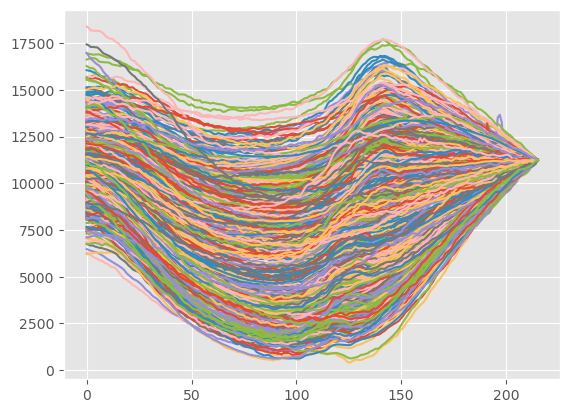

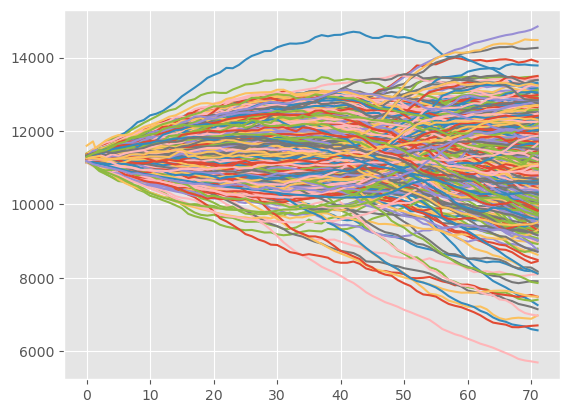

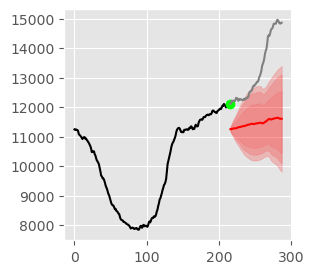

0 0
(657, 216) (657, 216)


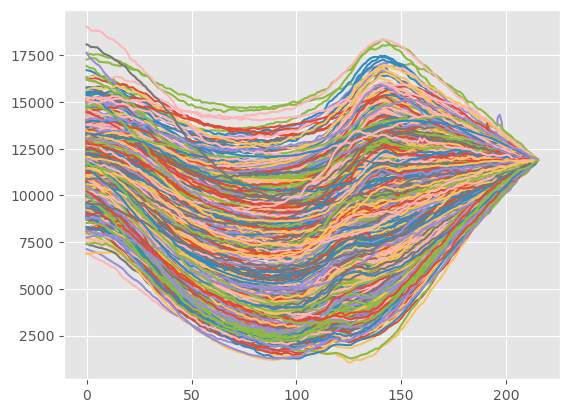

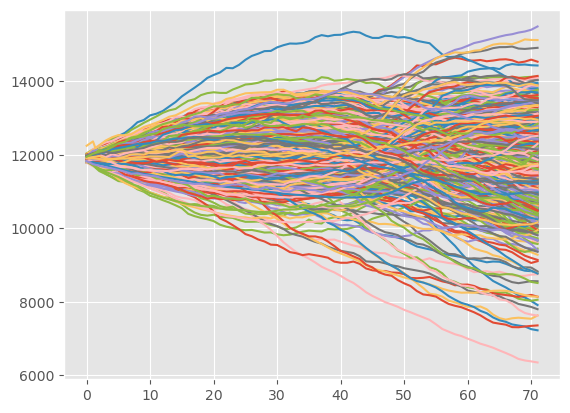

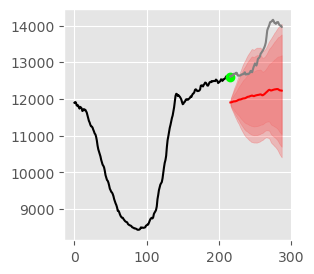

0 0
(657, 216) (657, 216)


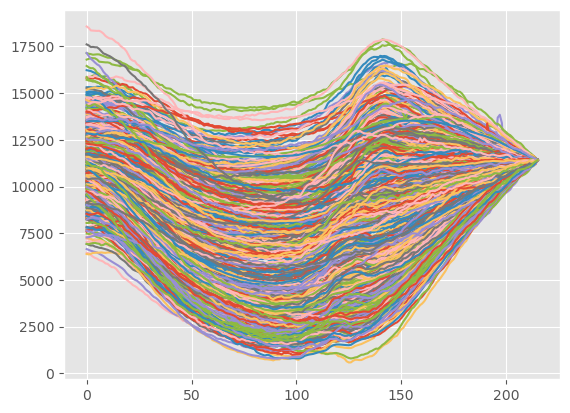

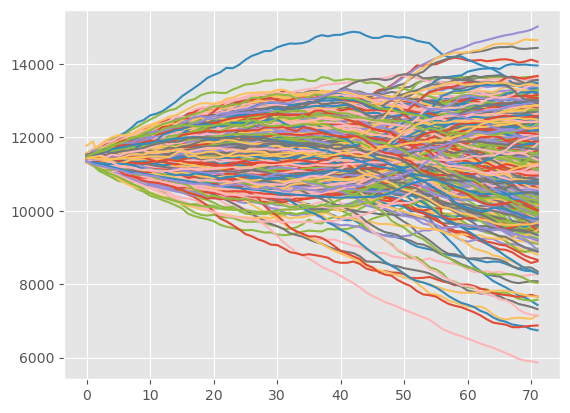

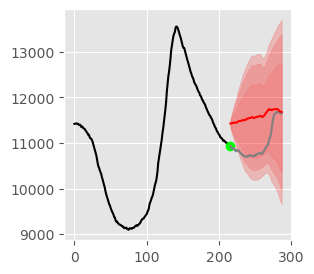

0 0
(657, 216) (657, 216)


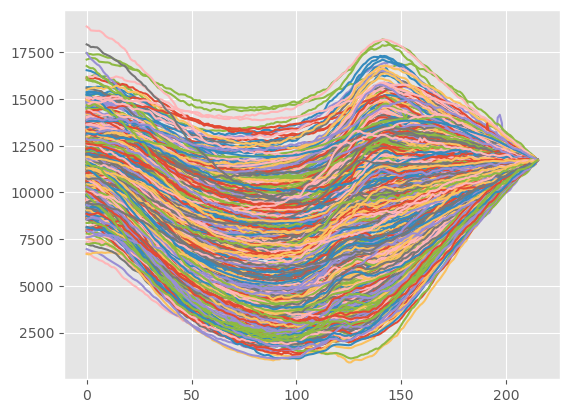

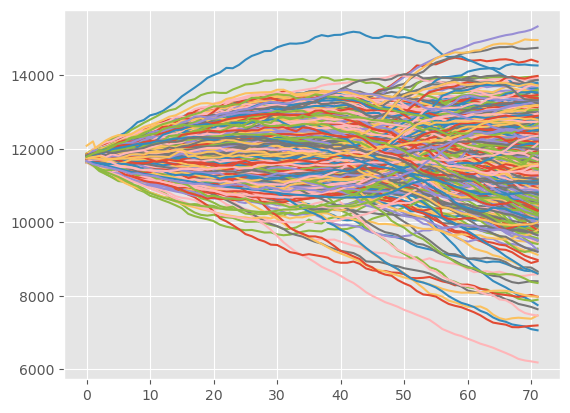

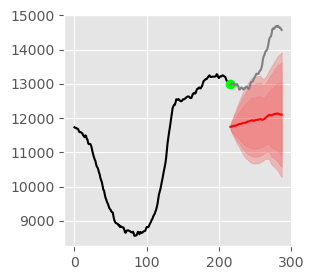

0 0
(657, 216) (657, 216)


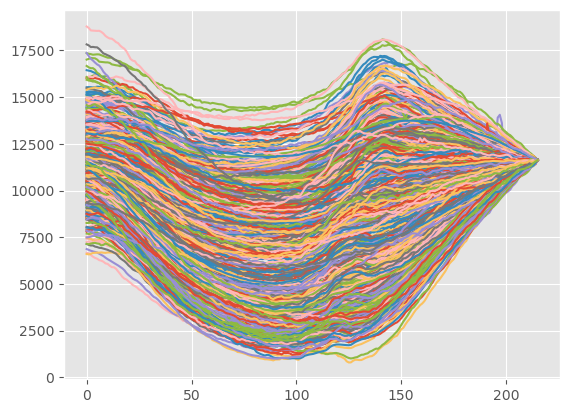

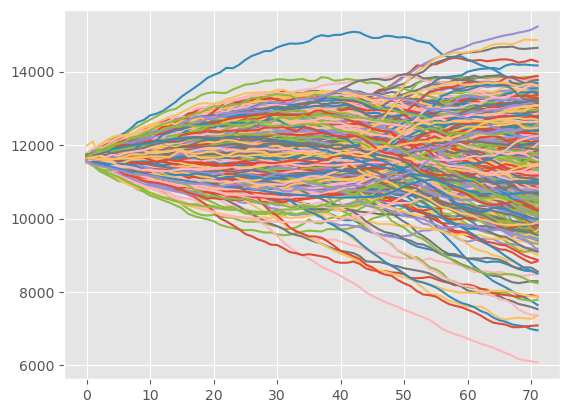

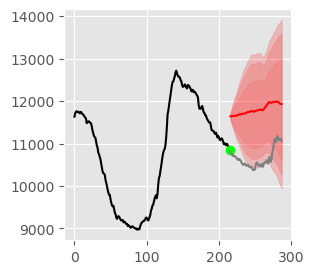

0 0
(657, 216) (657, 216)


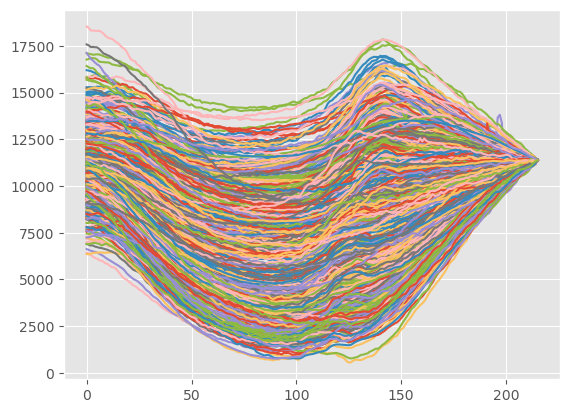

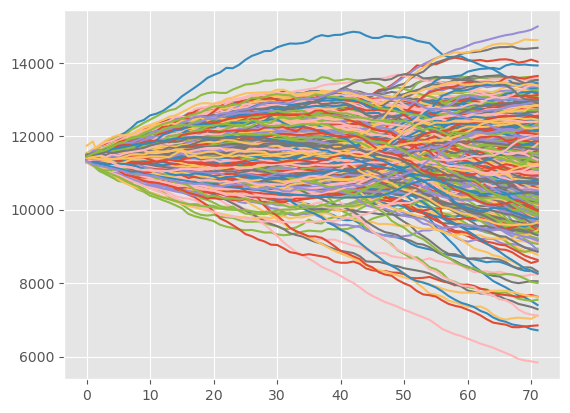

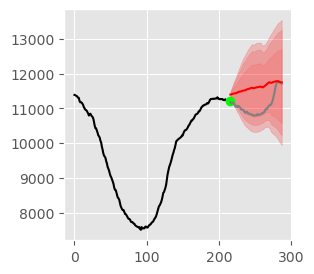

0 0
(657, 216) (657, 216)


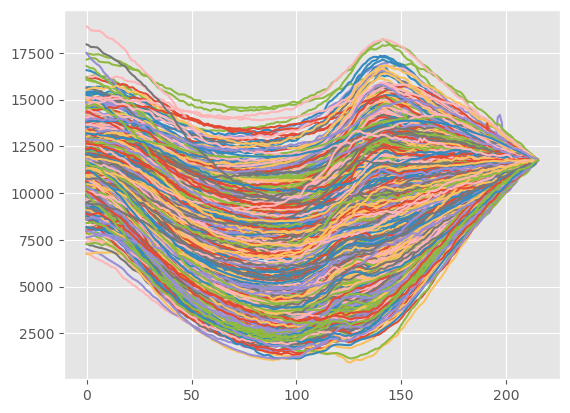

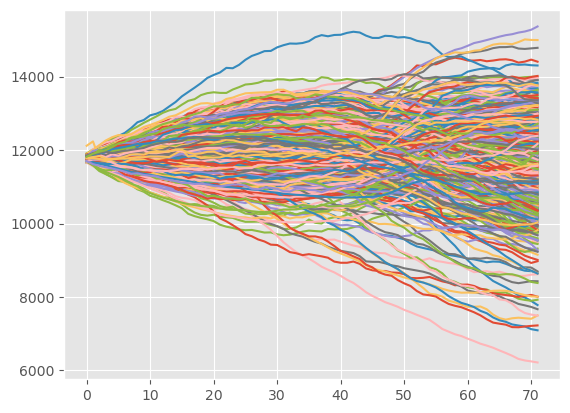

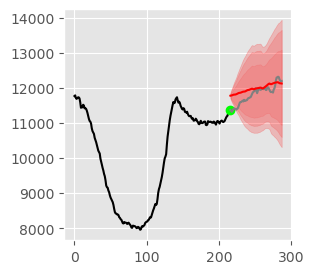

0 0
(657, 216) (657, 216)


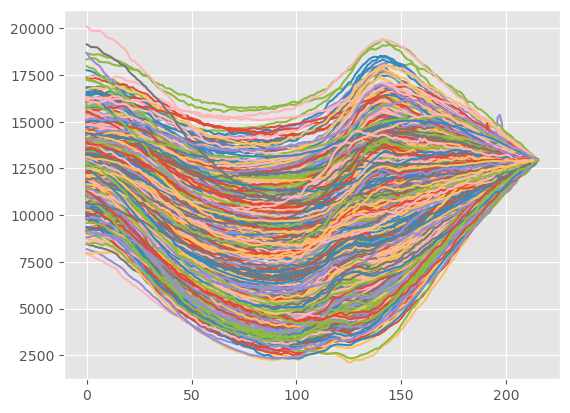

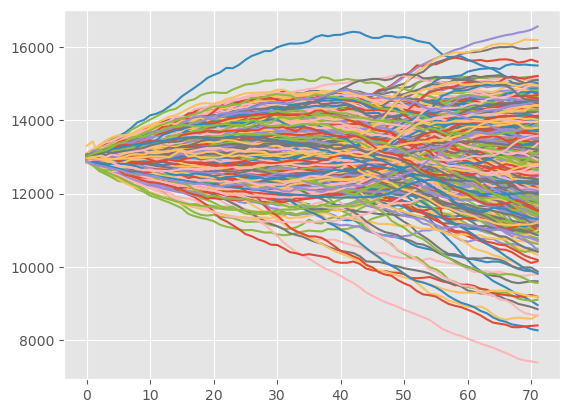

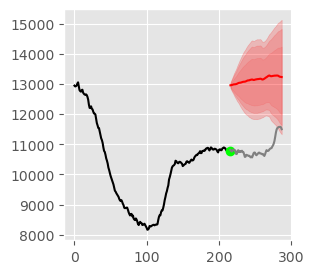

0 0
(657, 216) (657, 216)


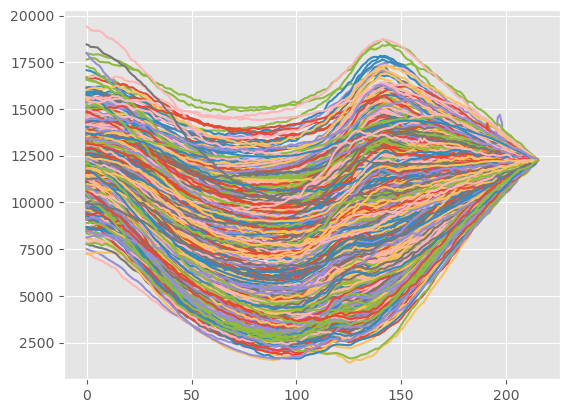

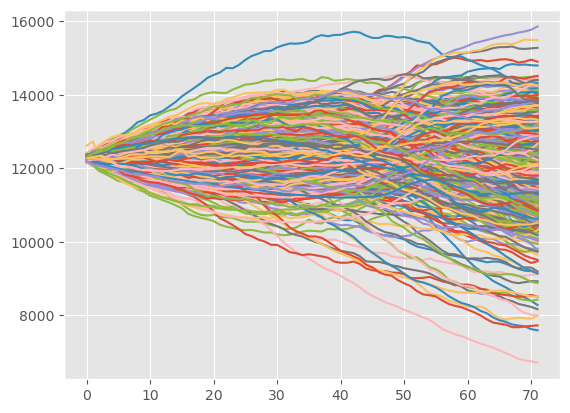

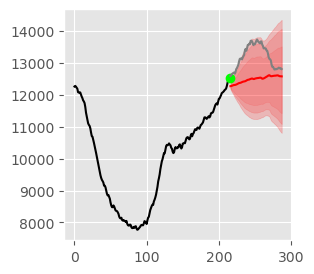

0 0
(657, 216) (657, 216)


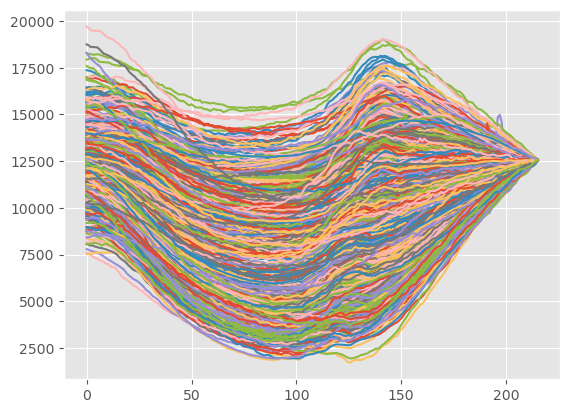

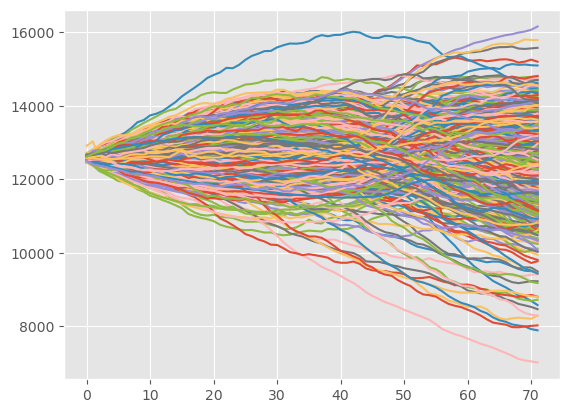

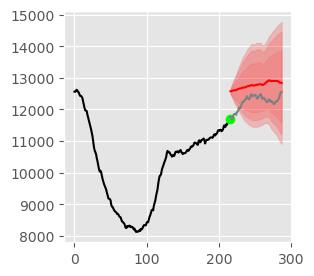

0 0
(657, 216) (657, 216)


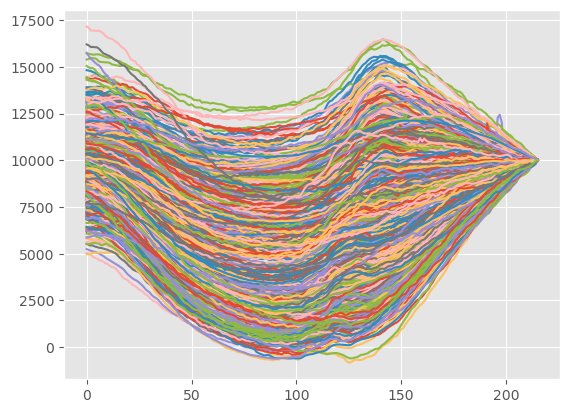

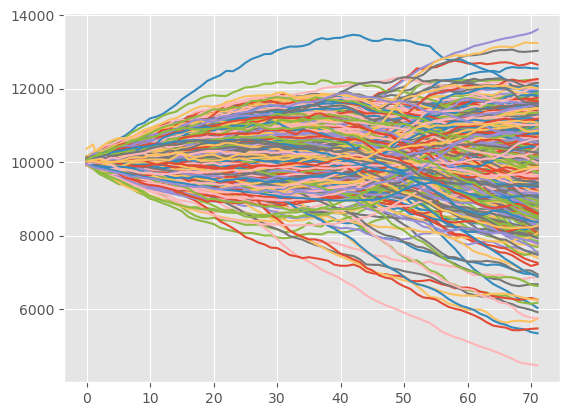

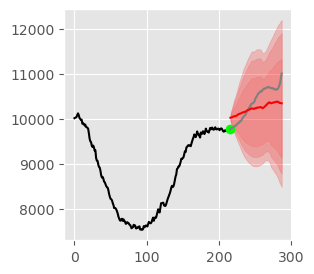

0 0
(657, 216) (657, 216)


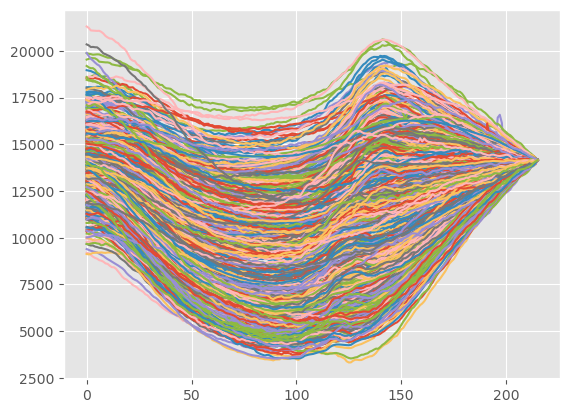

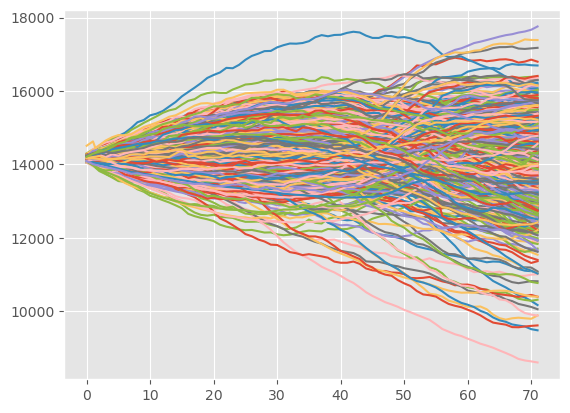

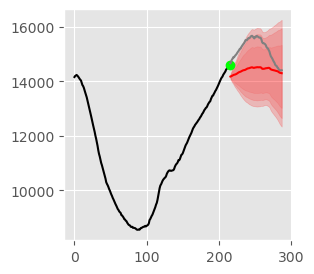

0 0
(657, 216) (657, 216)


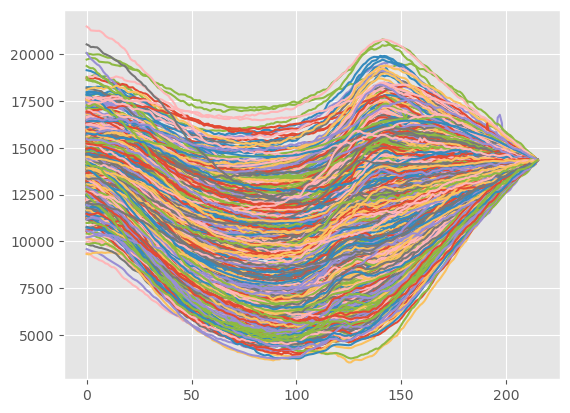

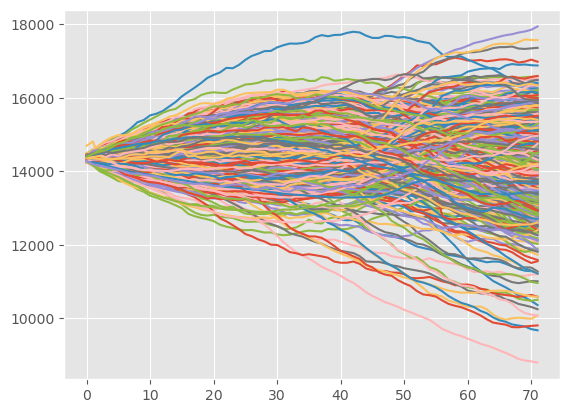

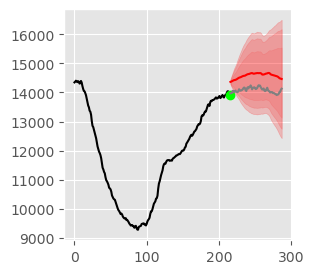

0 0
(657, 216) (657, 216)


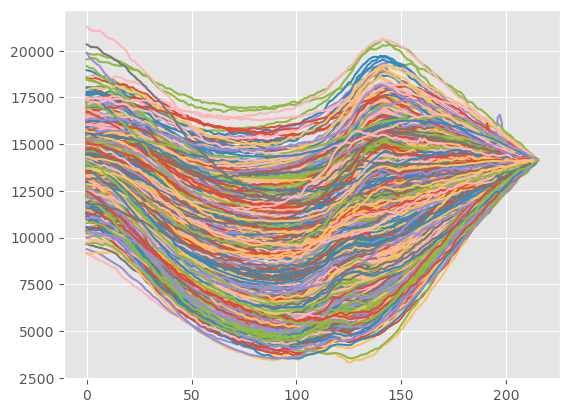

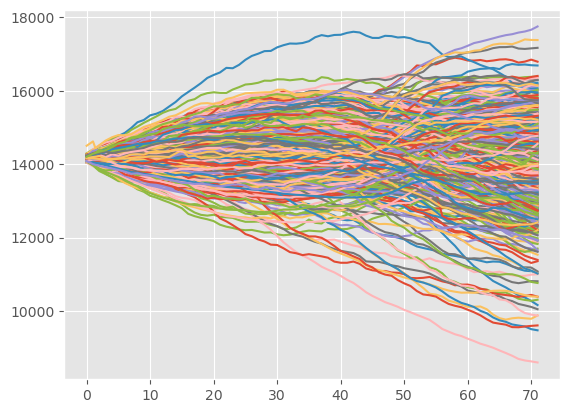

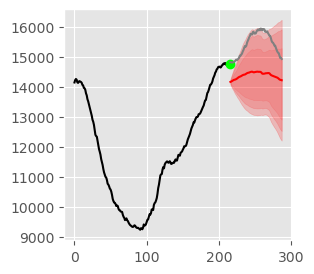

0 0
(657, 216) (657, 216)


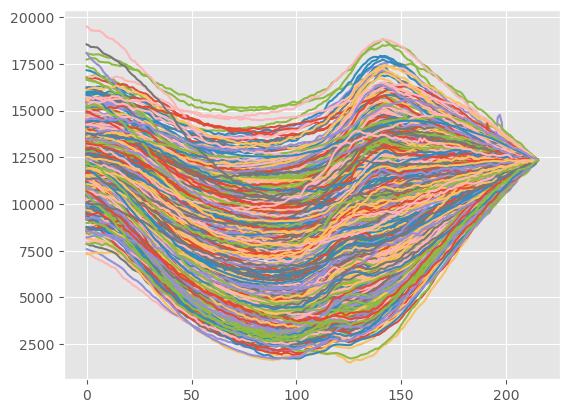

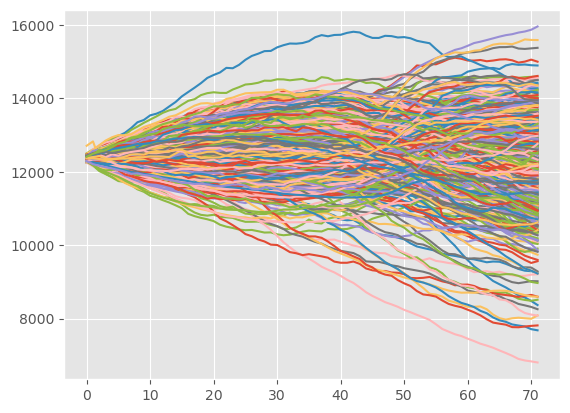

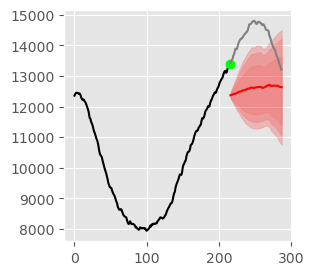

0 0
(657, 216) (657, 216)


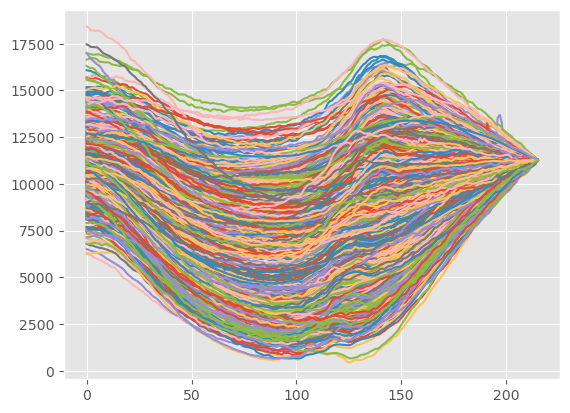

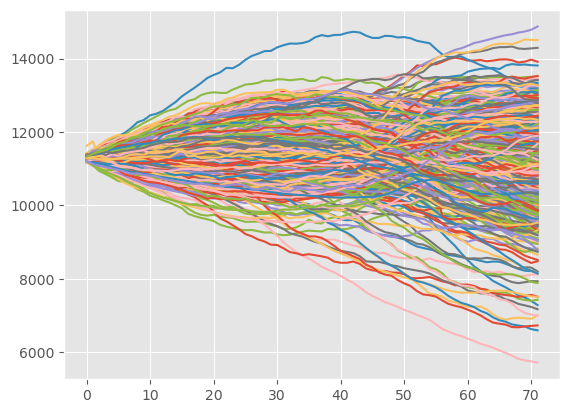

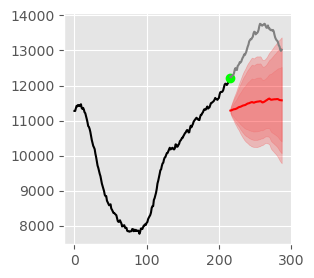

0 0
(657, 216) (657, 216)


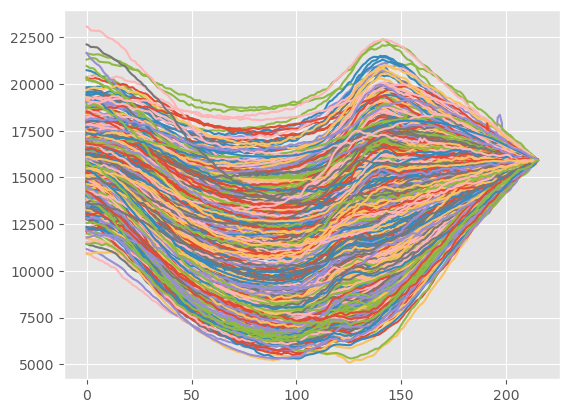

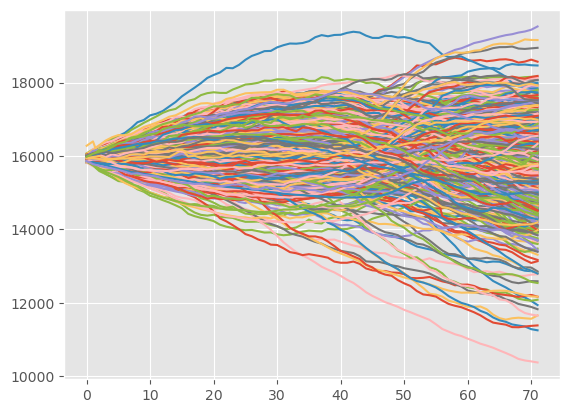

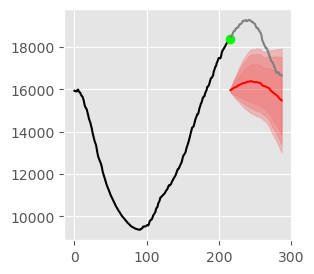

0 0
(657, 216) (657, 216)


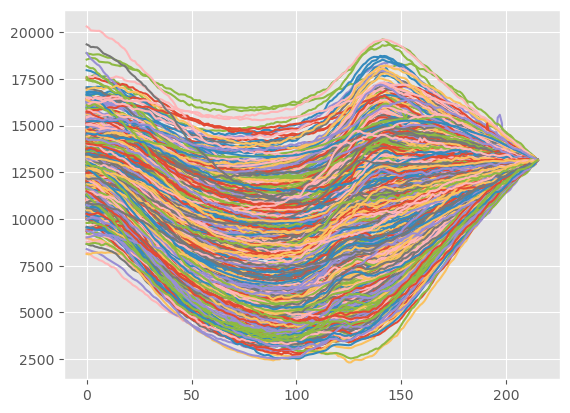

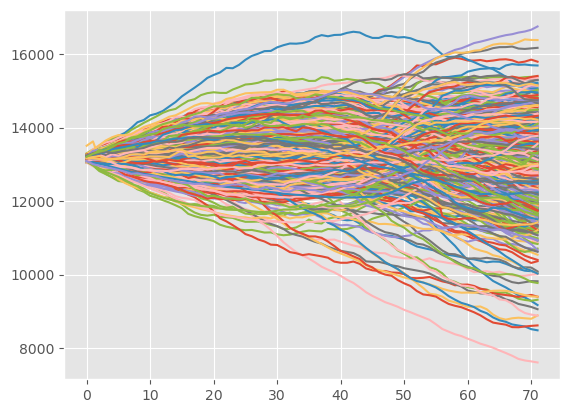

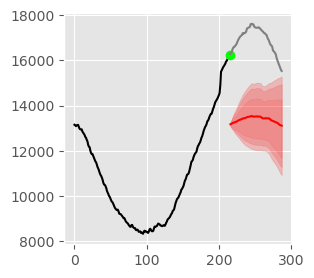

0 0
(657, 216) (657, 216)


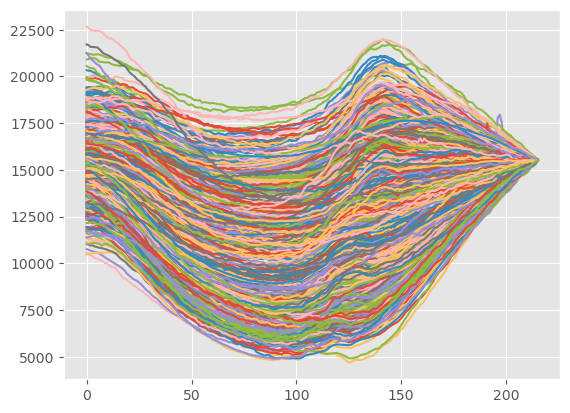

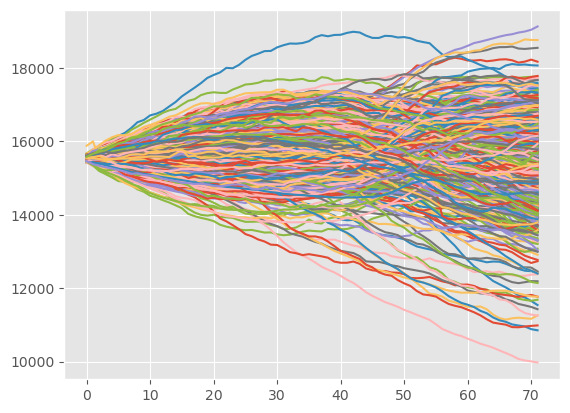

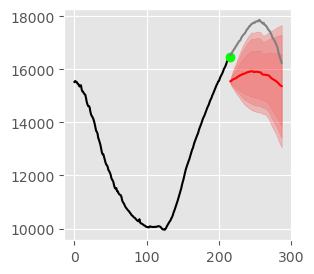

0 0
(657, 216) (657, 216)


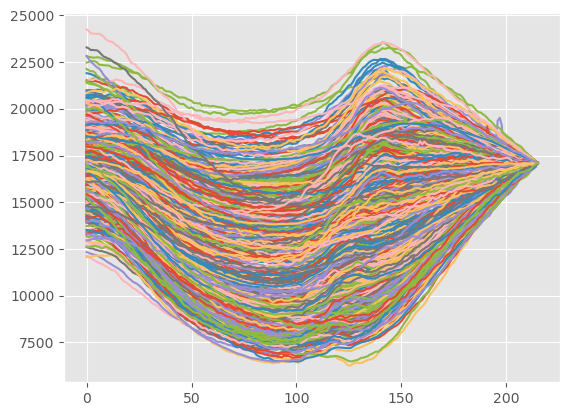

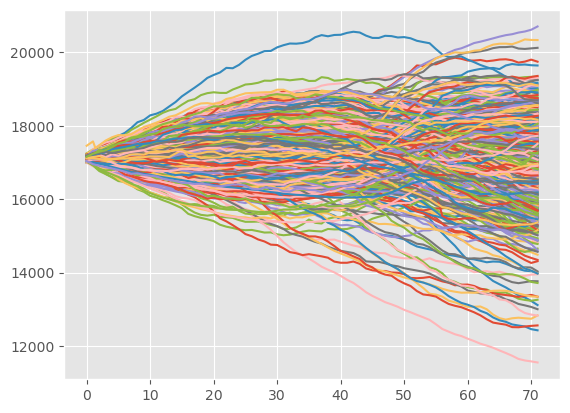

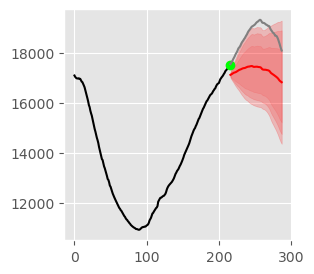

0 0
(657, 216) (657, 216)


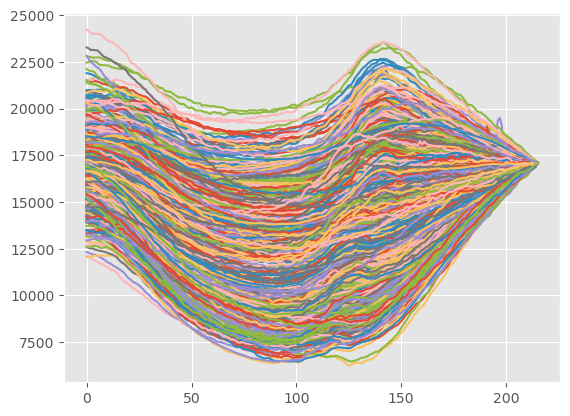

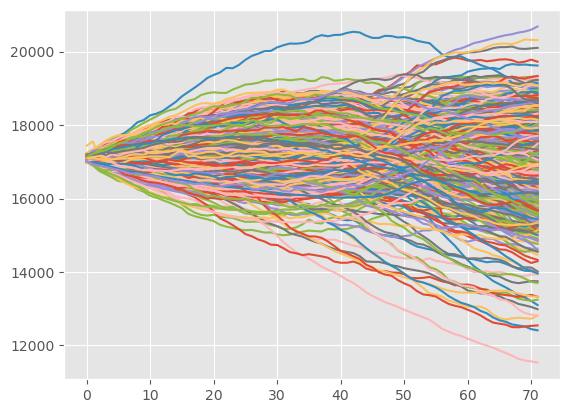

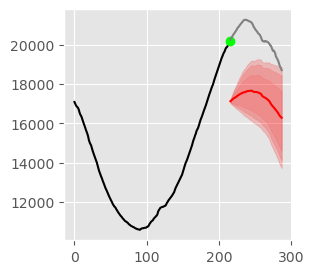

0 0
(657, 216) (657, 216)


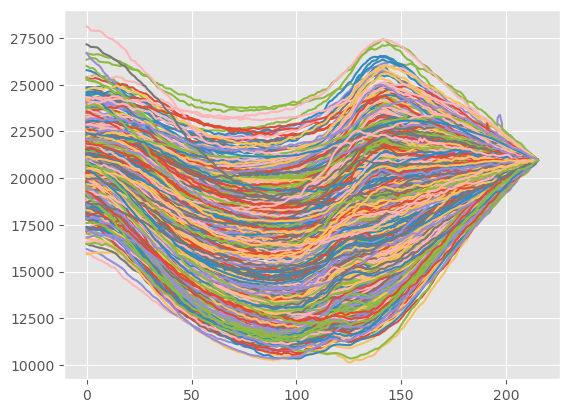

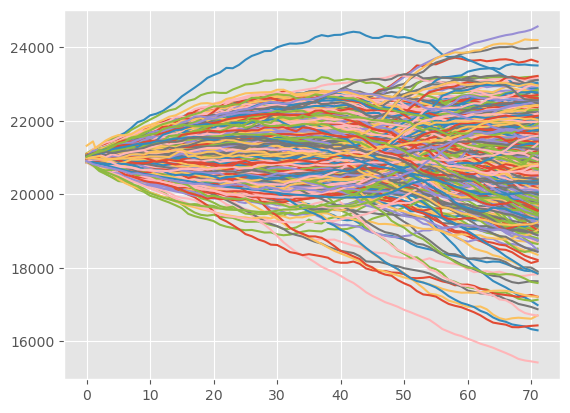

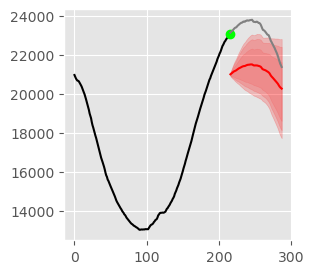

0 0
(657, 216) (657, 216)


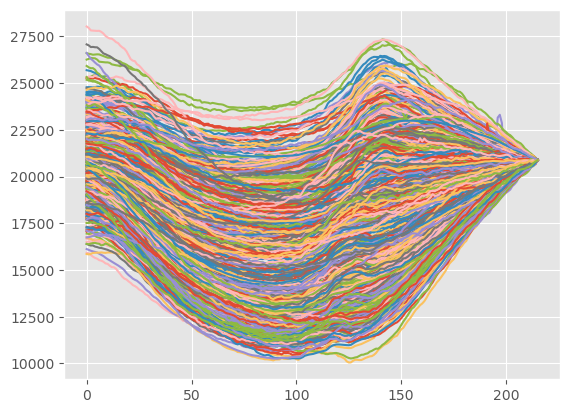

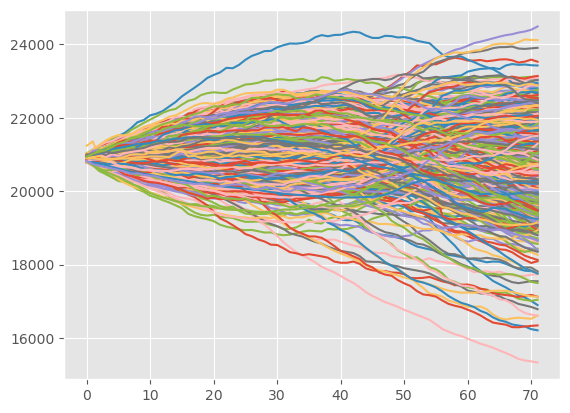

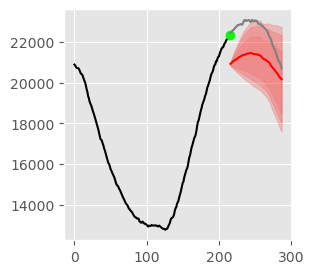

0 0
(657, 216) (657, 216)


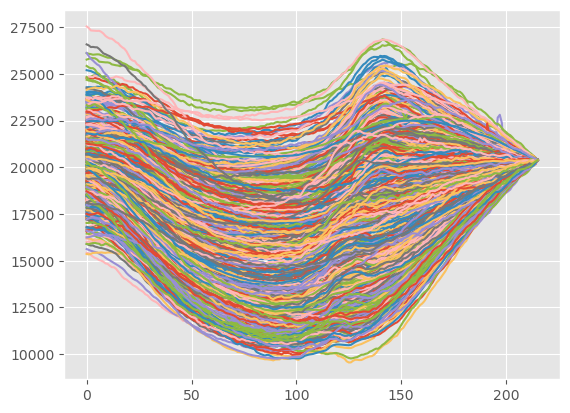

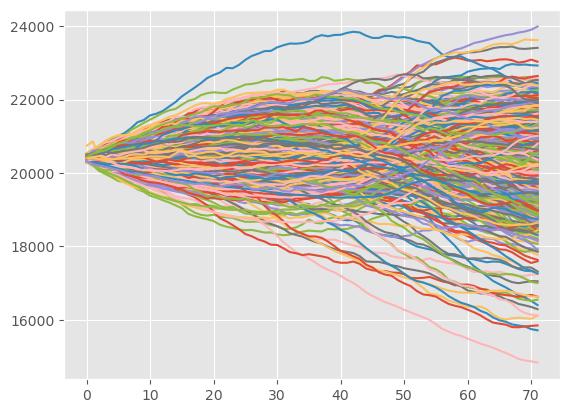

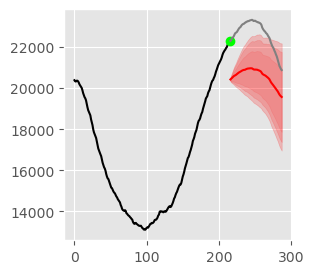

0 0
(657, 216) (657, 216)


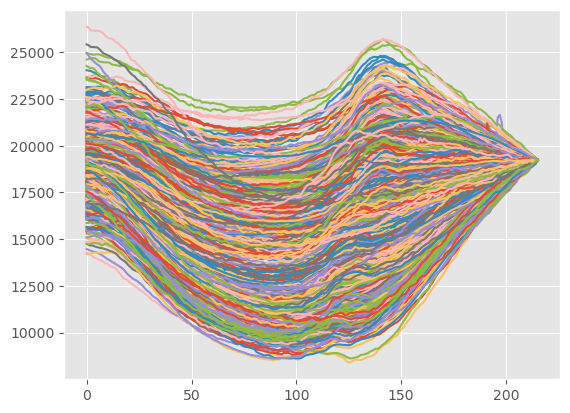

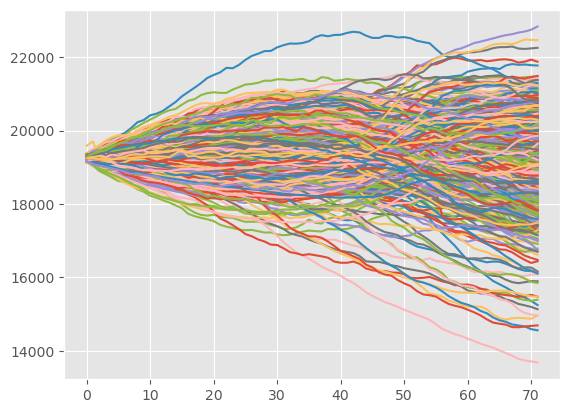

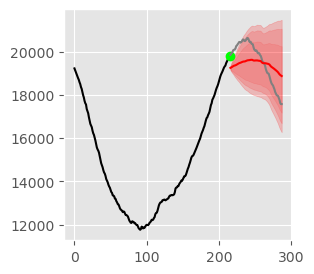

0 0
(657, 216) (657, 216)


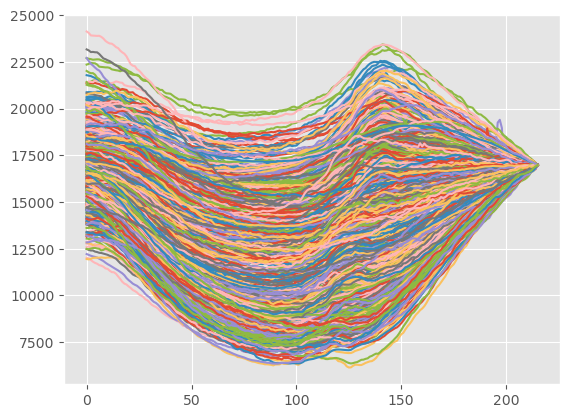

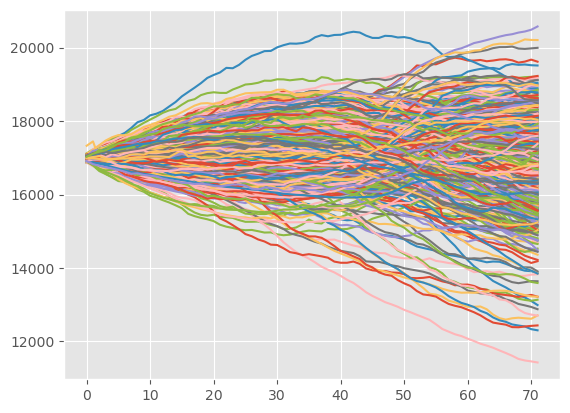

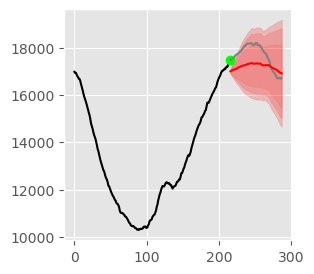

0 0
(657, 216) (657, 216)


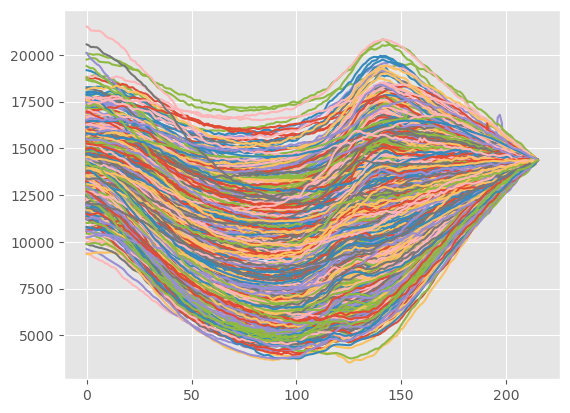

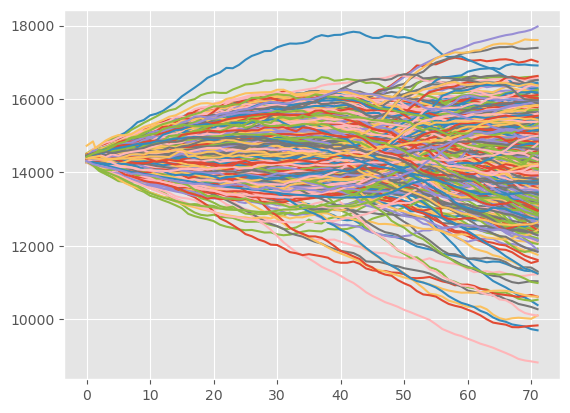

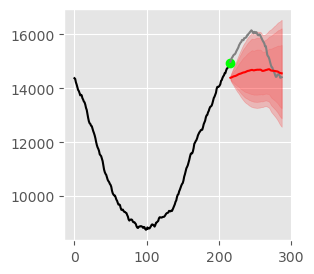

0 0
(657, 216) (657, 216)


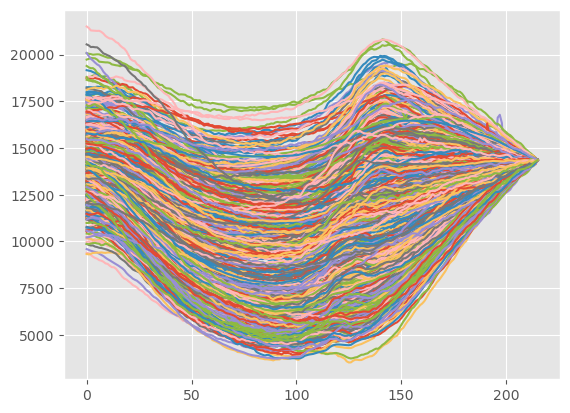

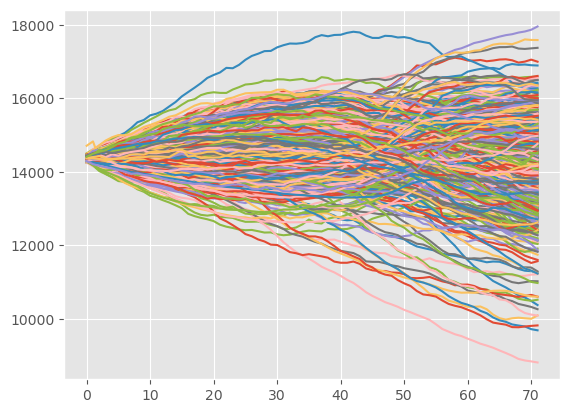

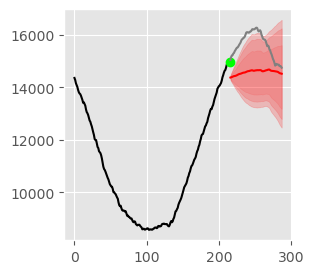

0 0
(657, 216) (657, 216)


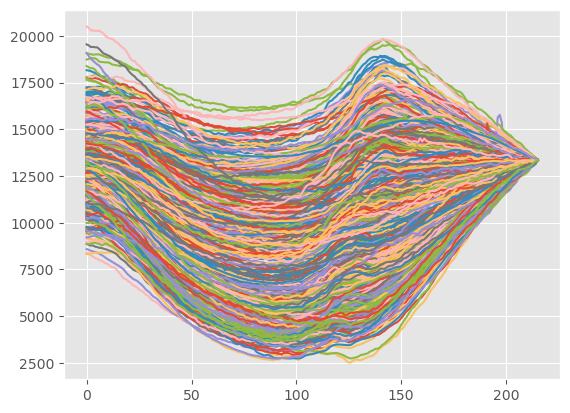

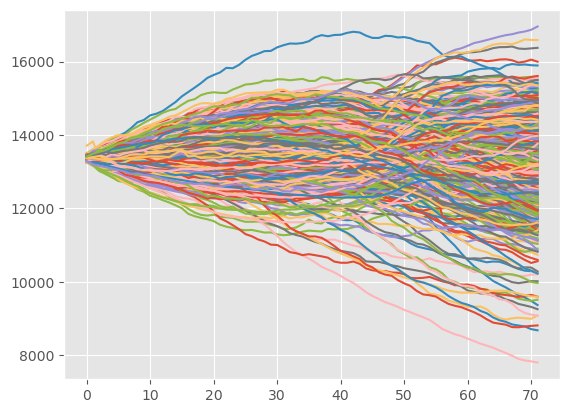

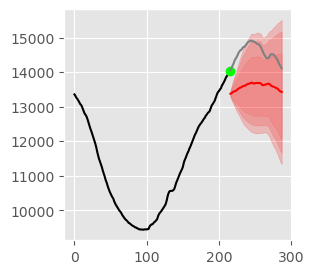

0 0
(657, 216) (657, 216)


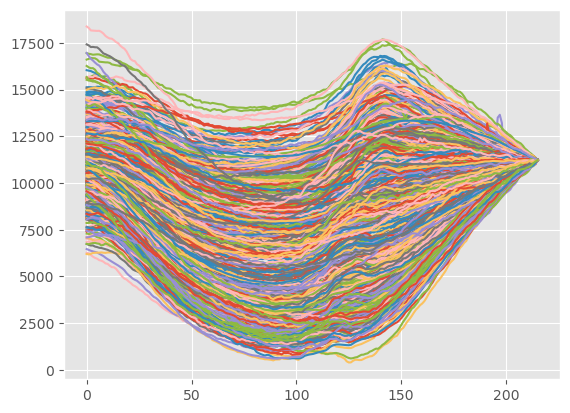

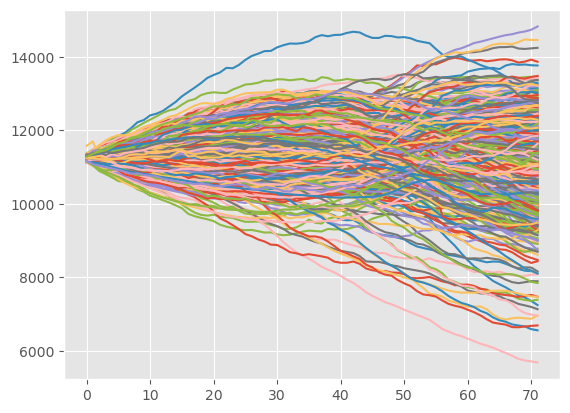

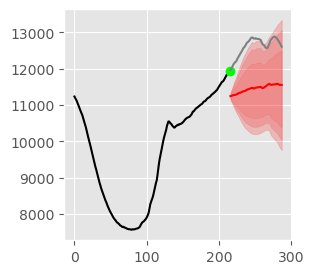

0 0
(657, 216) (657, 216)


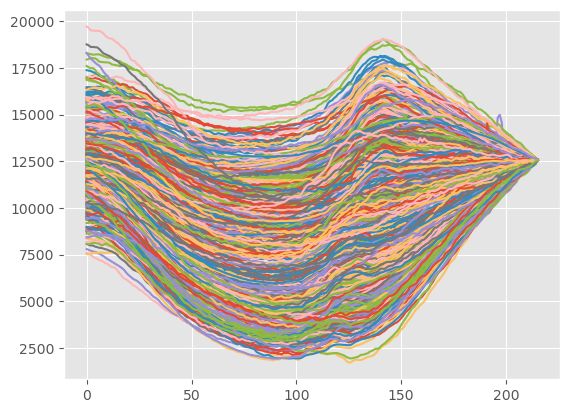

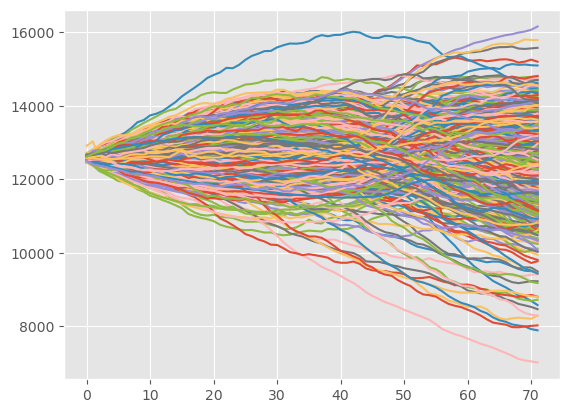

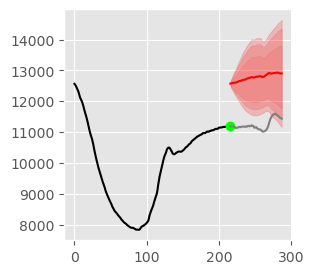

0 0
(657, 216) (657, 216)


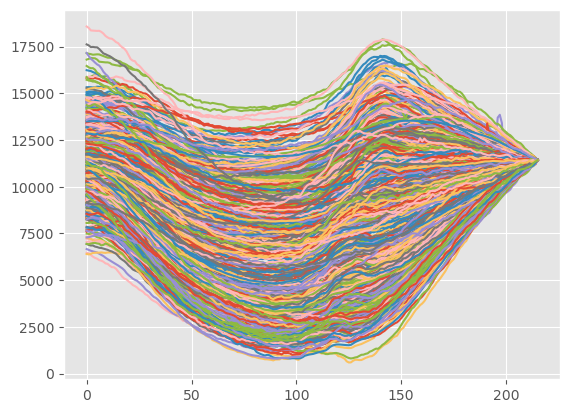

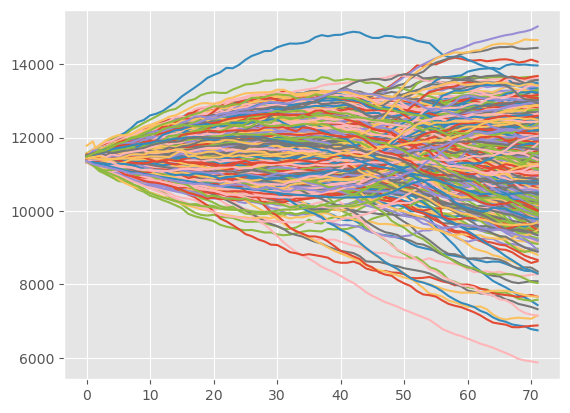

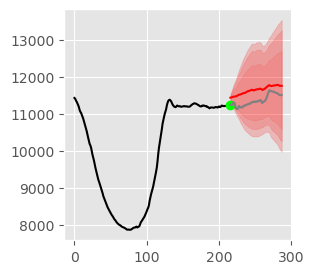

0 0
(657, 216) (657, 216)


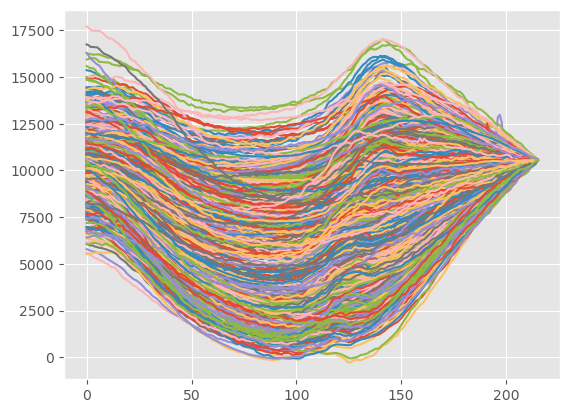

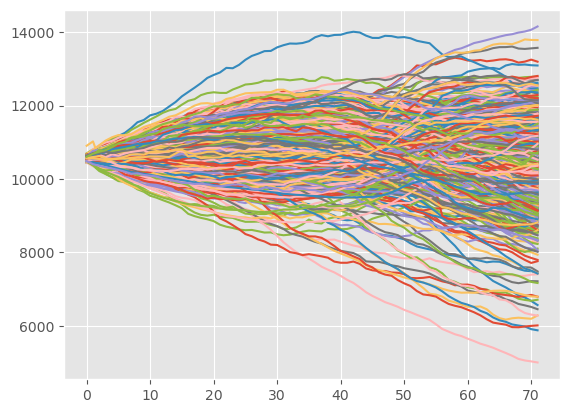

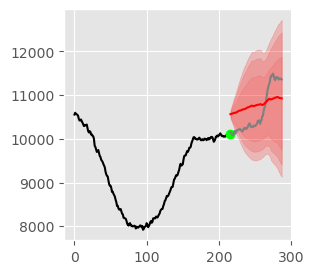

0 0
(657, 216) (657, 216)


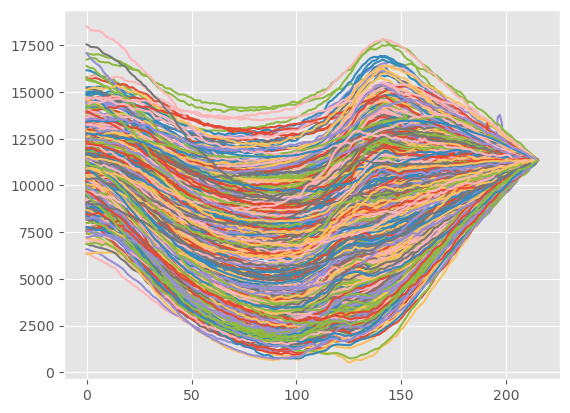

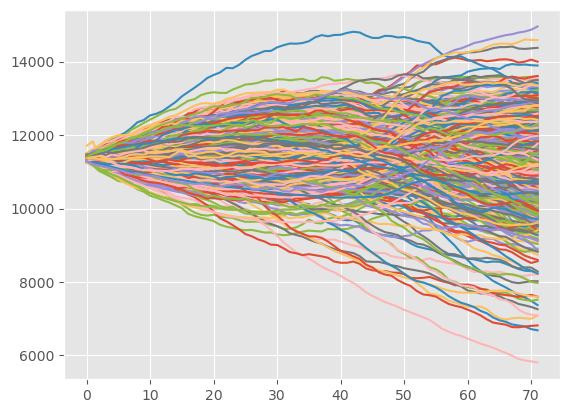

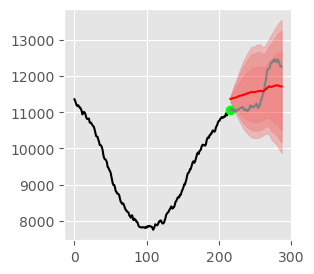

0 0
(657, 216) (657, 216)


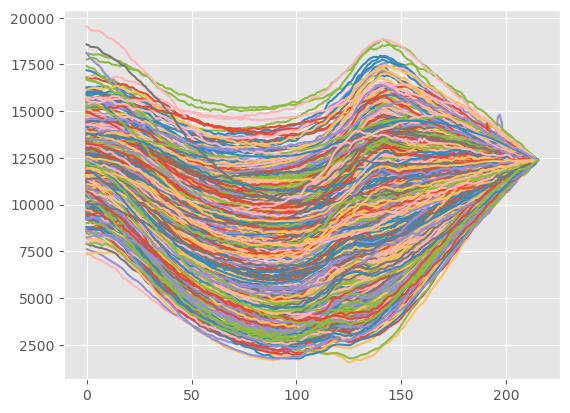

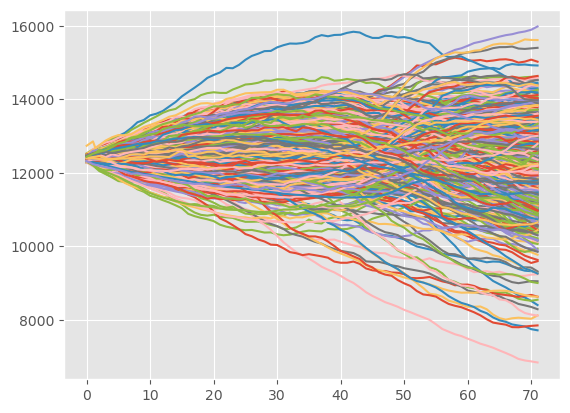

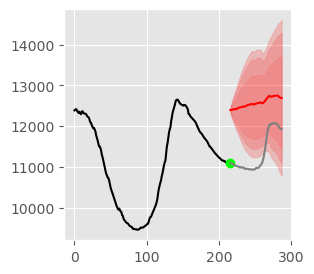

0 0
(657, 216) (657, 216)


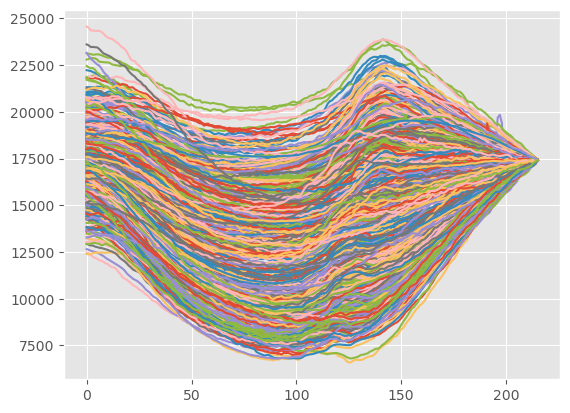

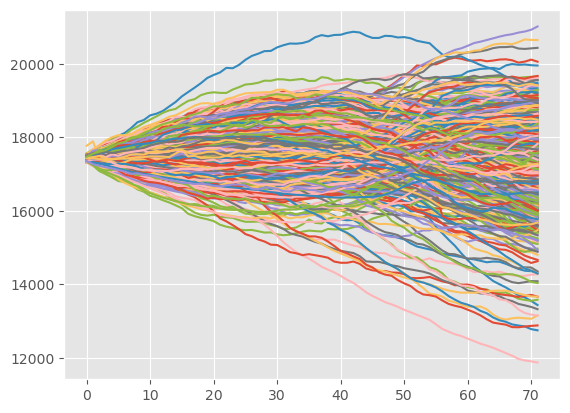

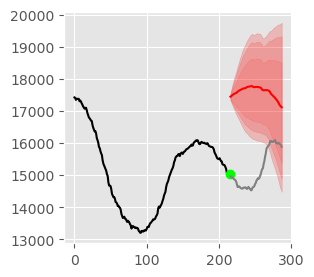

0 0
(657, 216) (657, 216)


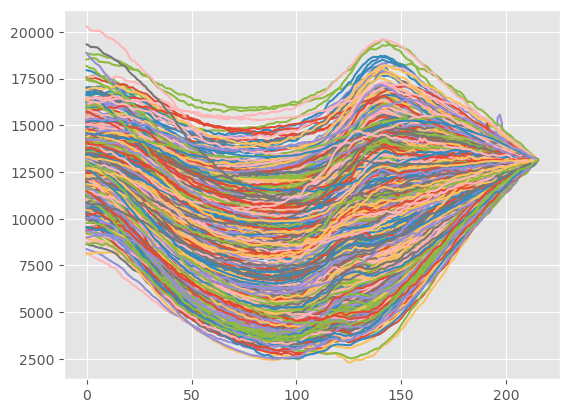

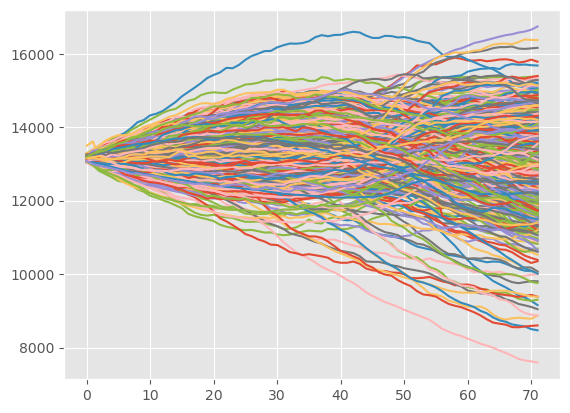

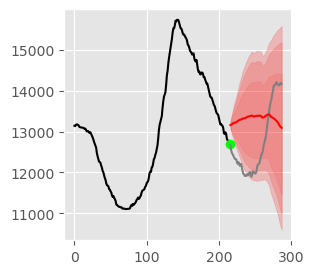

0 0
(657, 216) (657, 216)


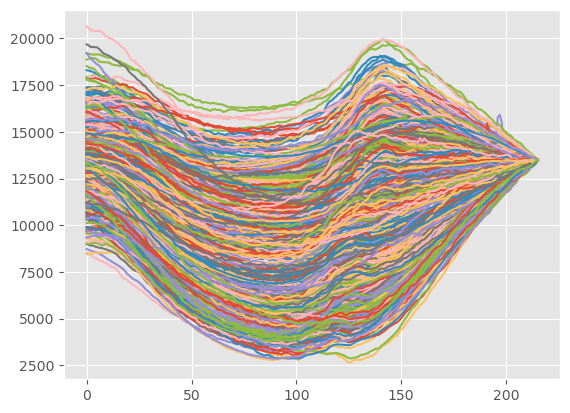

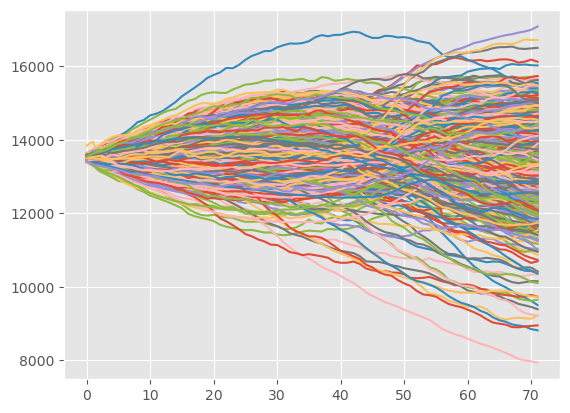

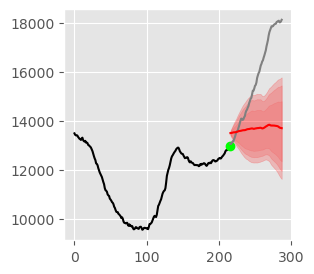

0 0
(657, 216) (657, 216)


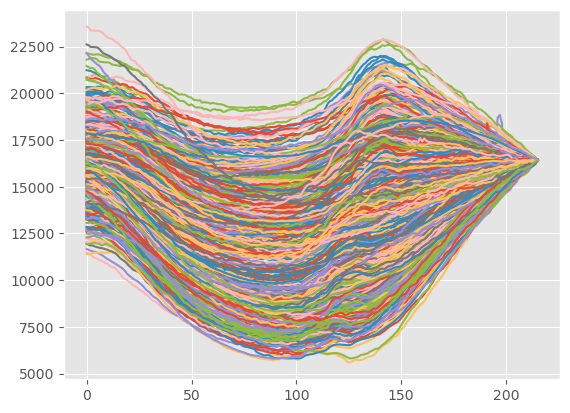

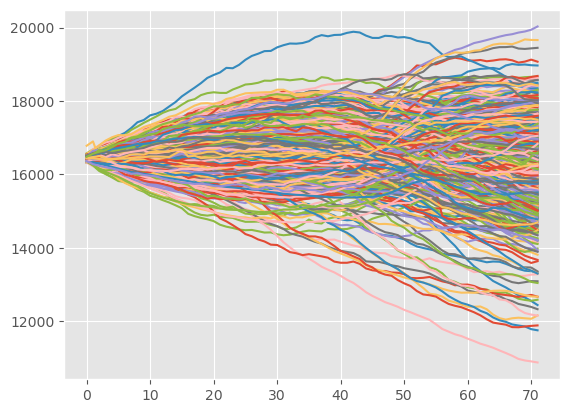

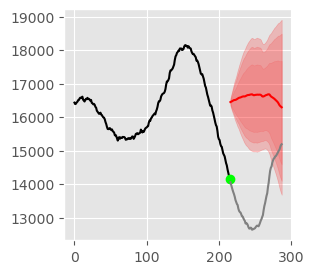

0 0
(657, 216) (657, 216)


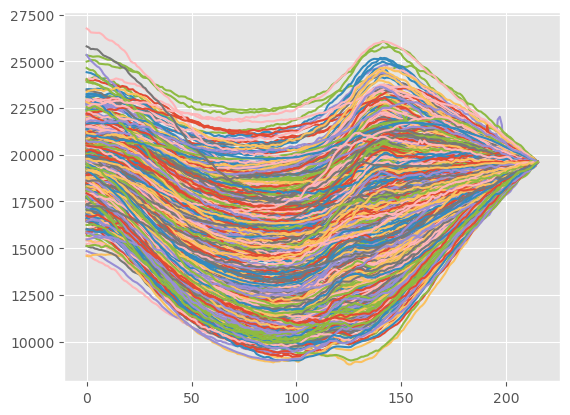

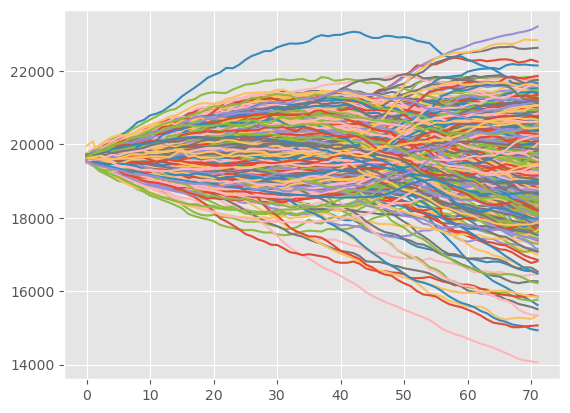

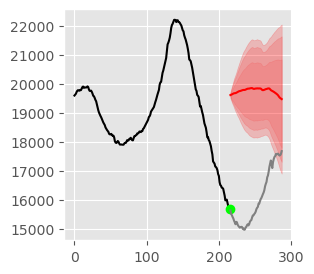

0 0
(657, 216) (657, 216)


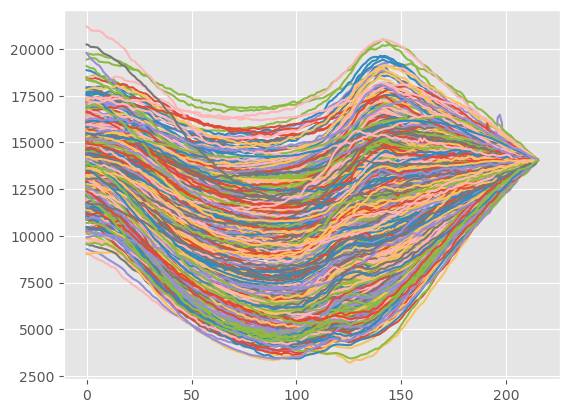

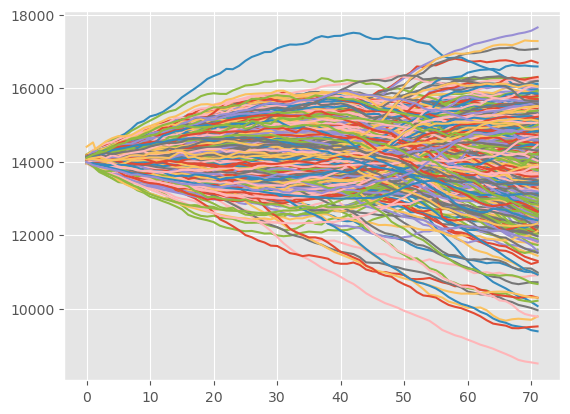

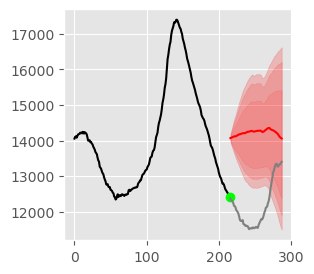

0 0
(657, 216) (657, 216)


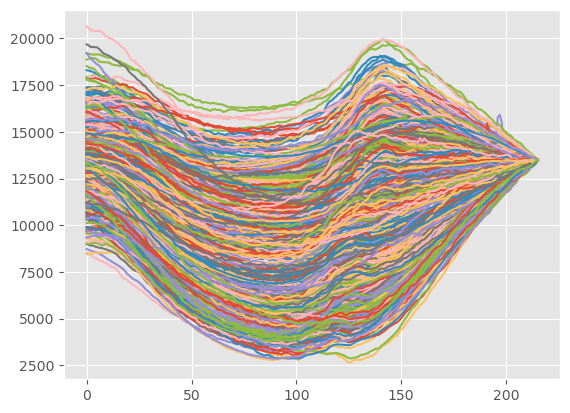

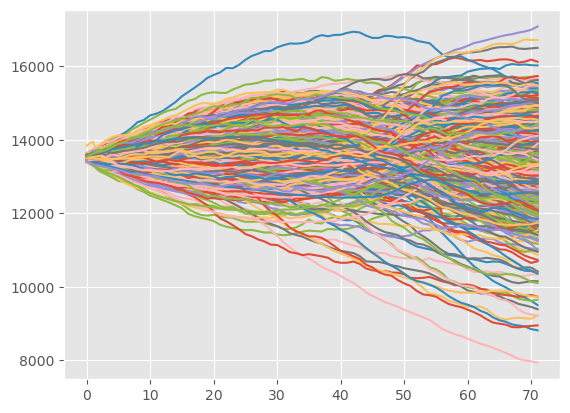

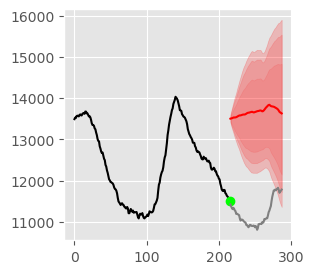

0 0
(657, 216) (657, 216)


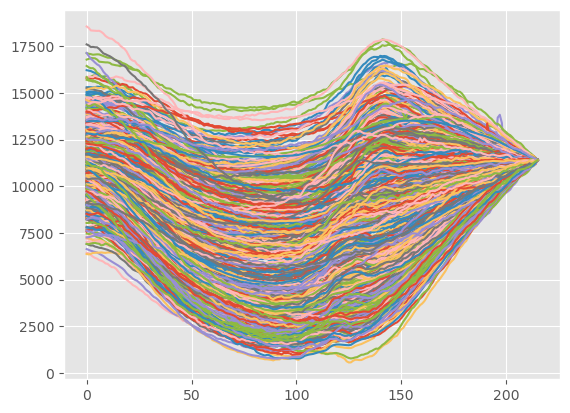

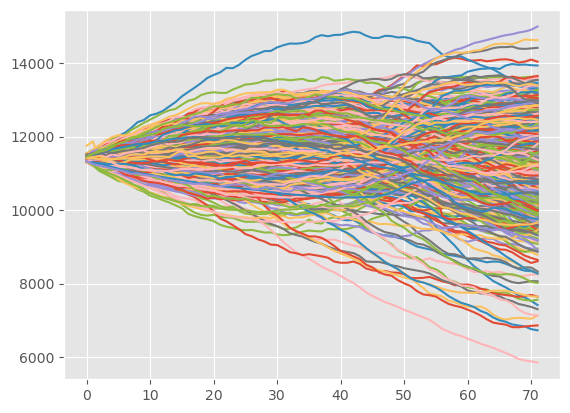

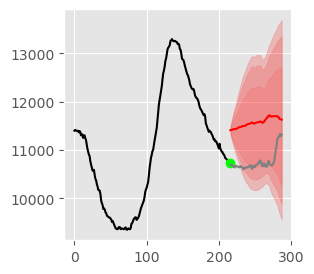

0 0
(657, 216) (657, 216)


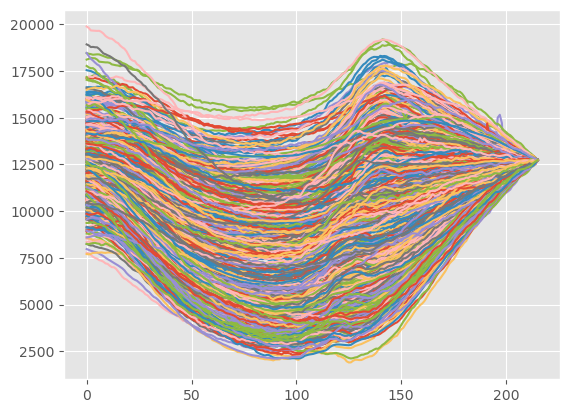

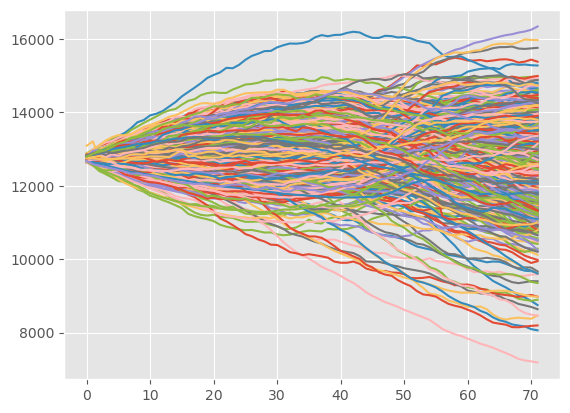

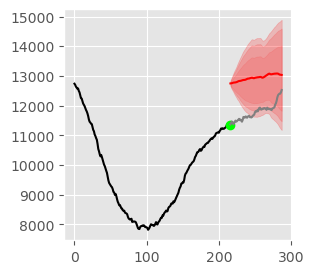

0 0
(657, 216) (657, 216)


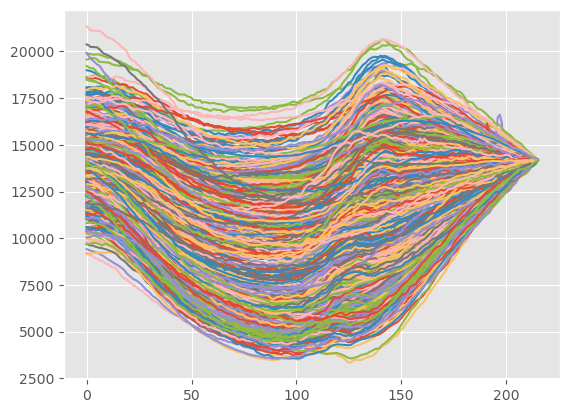

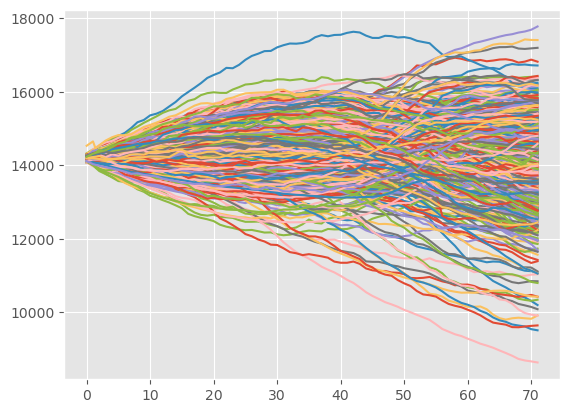

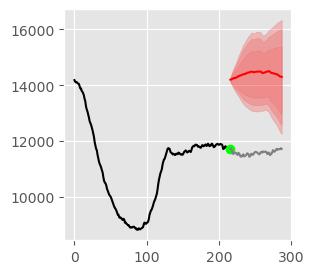

0 0
(657, 216) (657, 216)


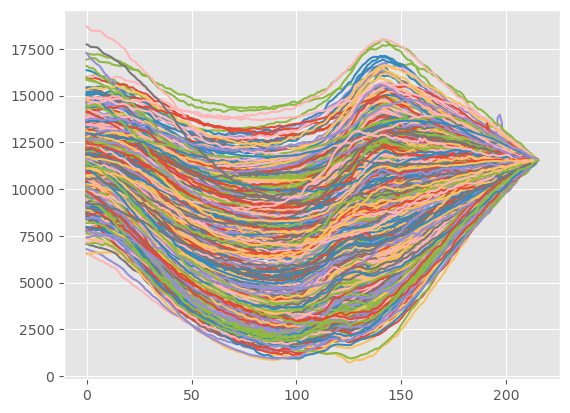

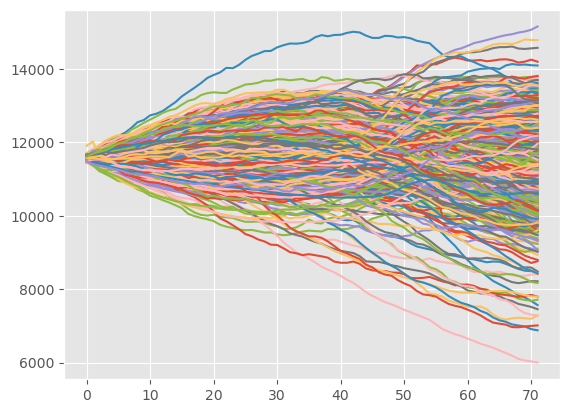

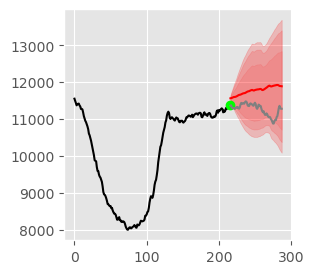

0 0
(657, 216) (657, 216)


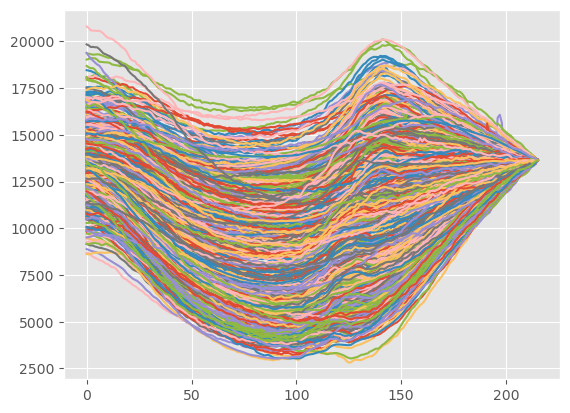

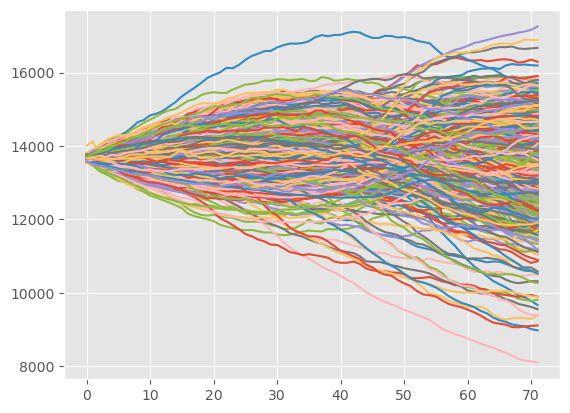

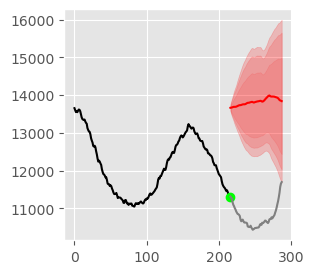

0 0
(657, 216) (657, 216)


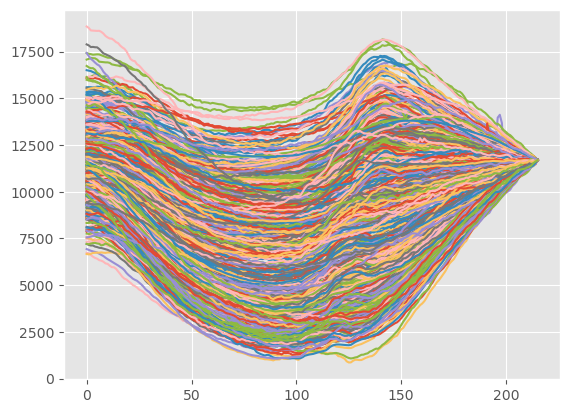

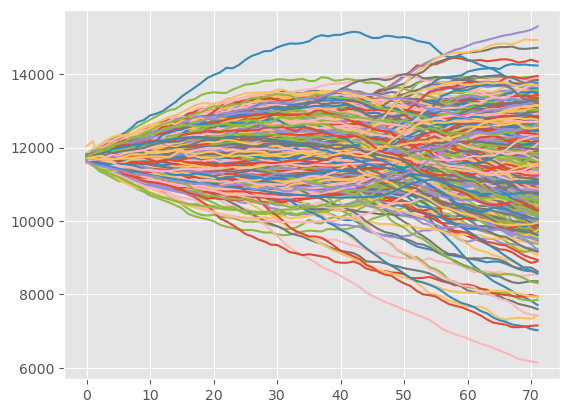

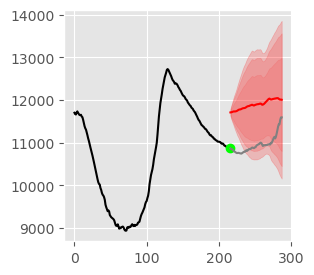

0 0
(657, 216) (657, 216)


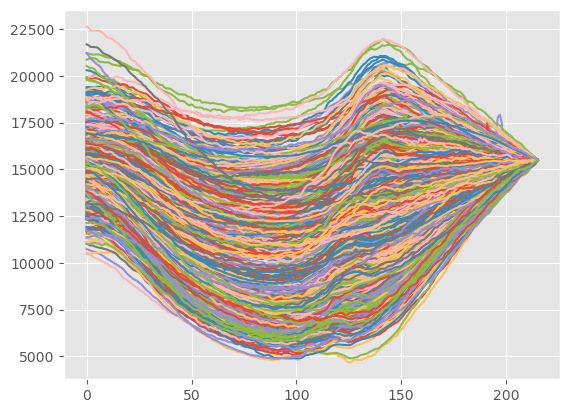

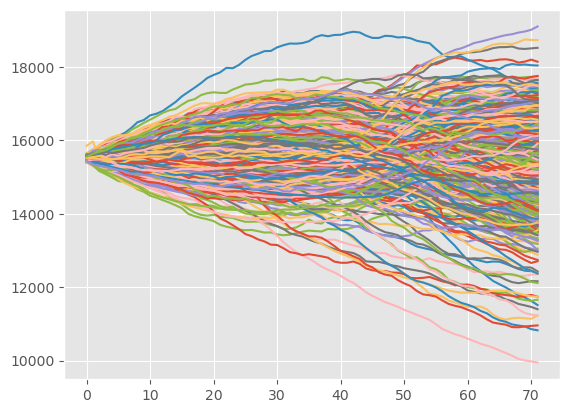

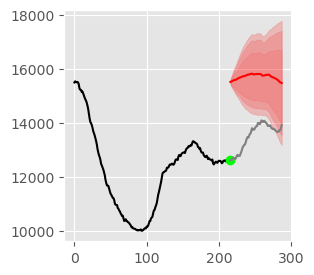

0 0
(657, 216) (657, 216)


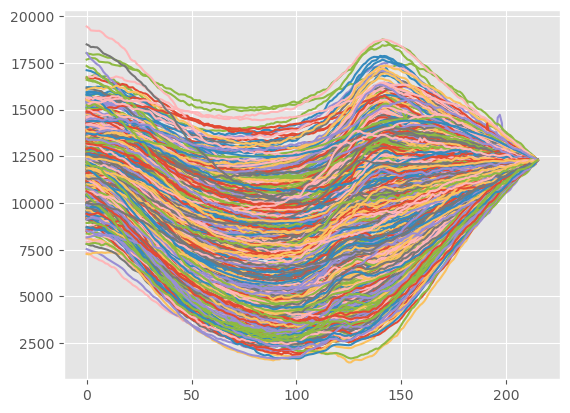

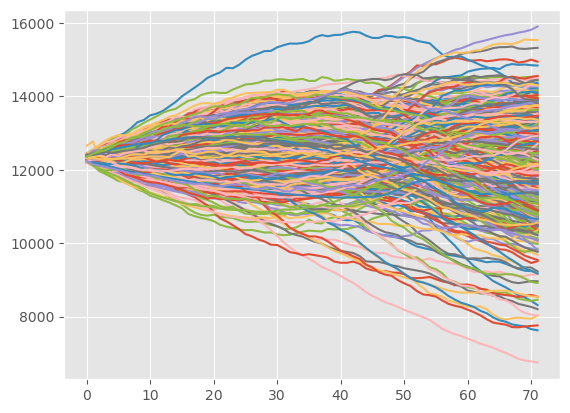

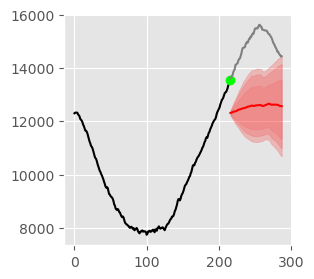

0 0
(657, 216) (657, 216)


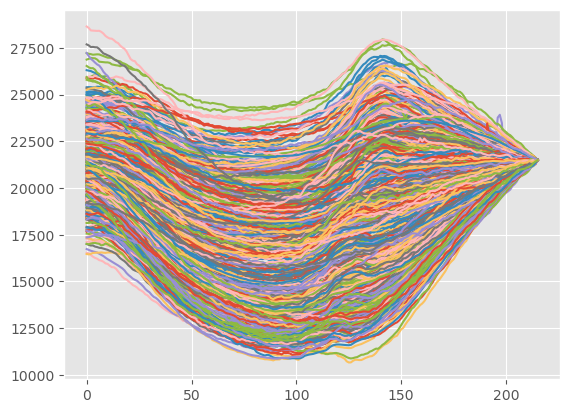

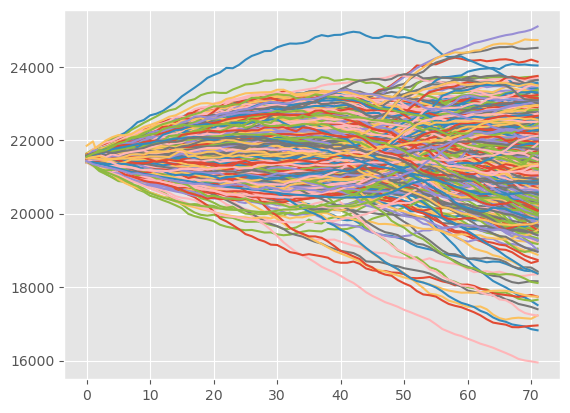

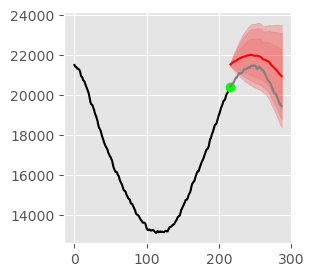

0 0
(657, 216) (657, 216)


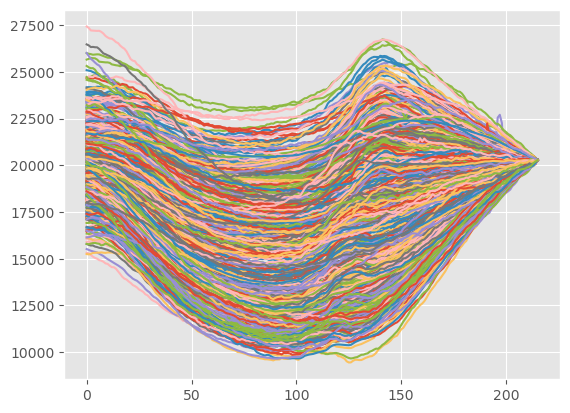

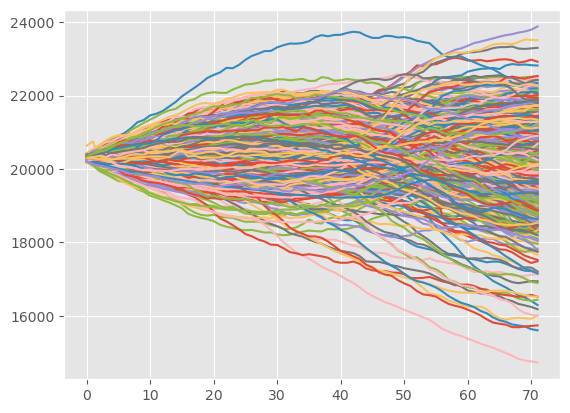

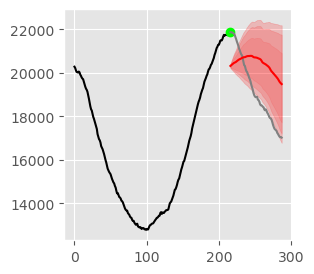

0 0
(657, 216) (657, 216)


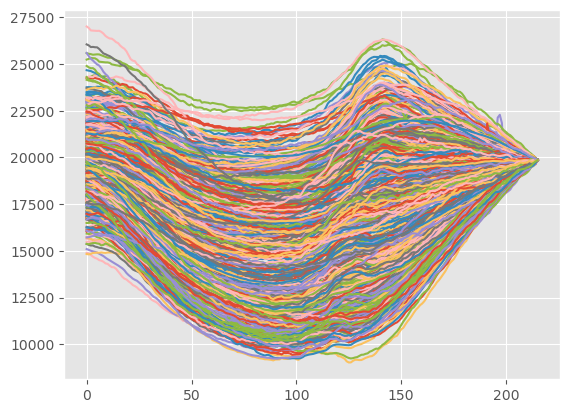

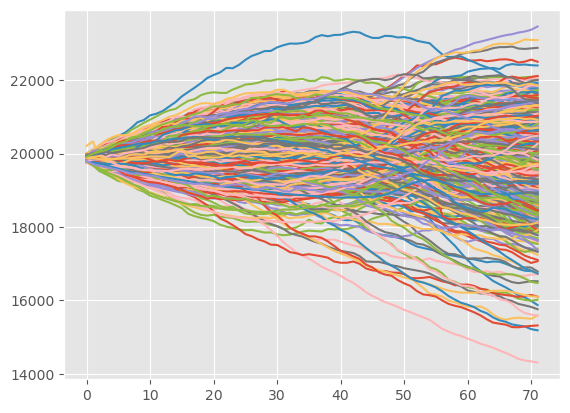

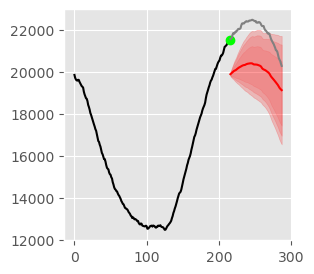

0 0
(657, 216) (657, 216)


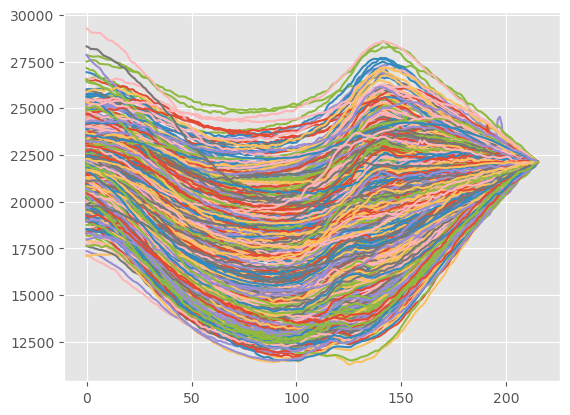

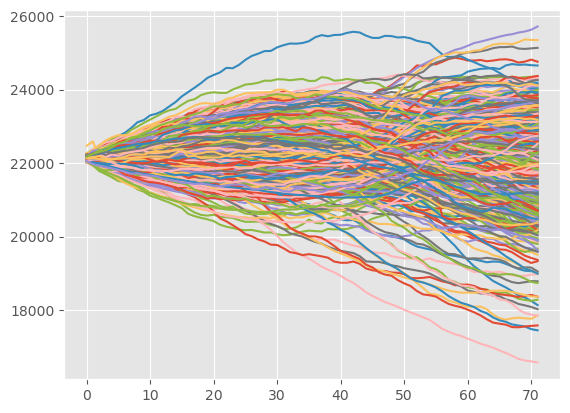

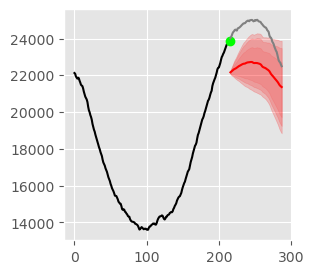

0 0
(657, 216) (657, 216)


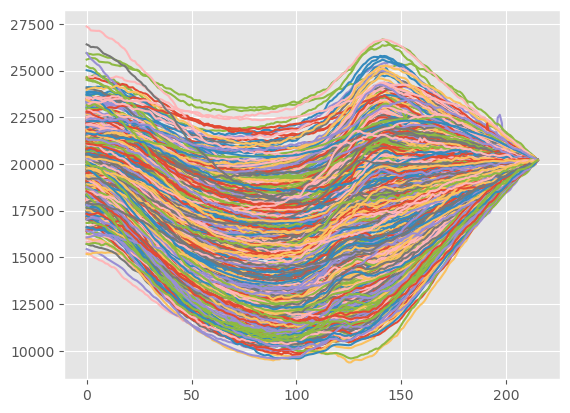

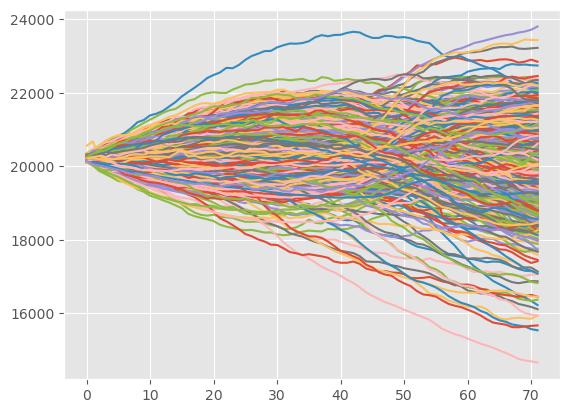

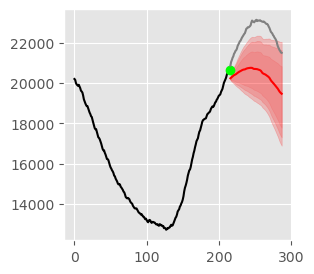

0 0
(657, 216) (657, 216)


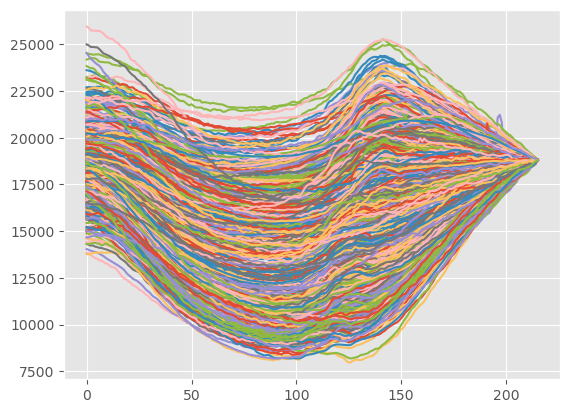

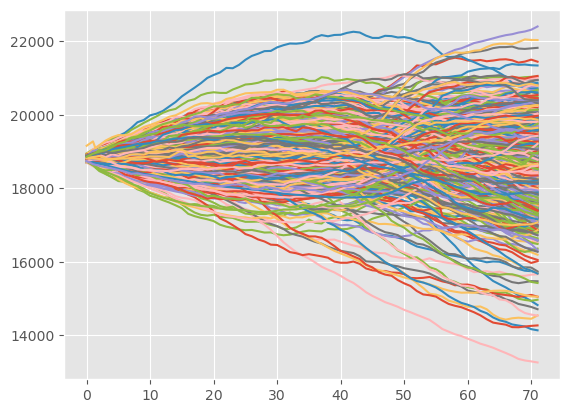

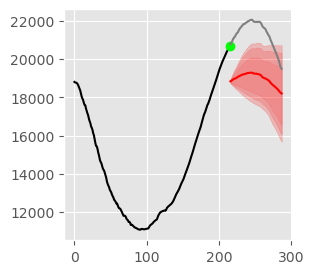

0 0
(657, 216) (657, 216)


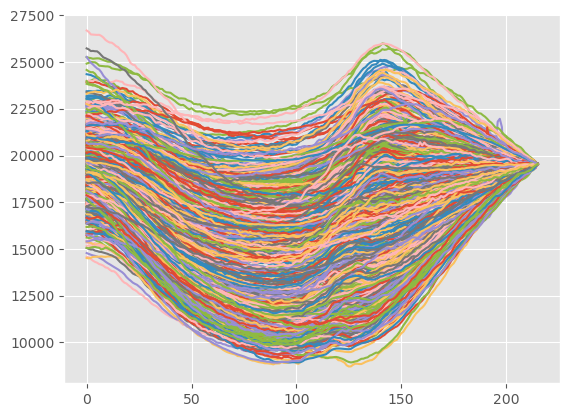

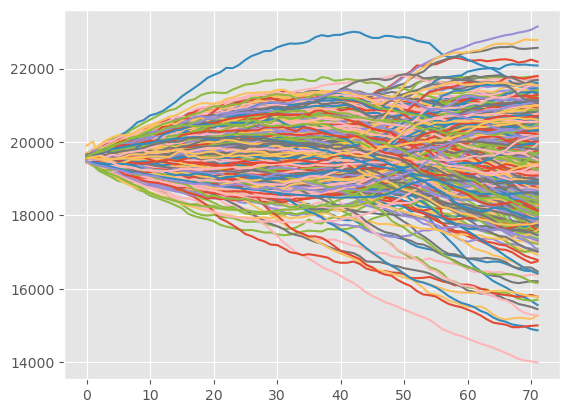

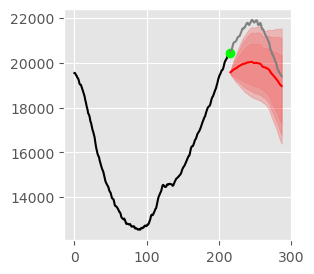

0 0
(657, 216) (657, 216)


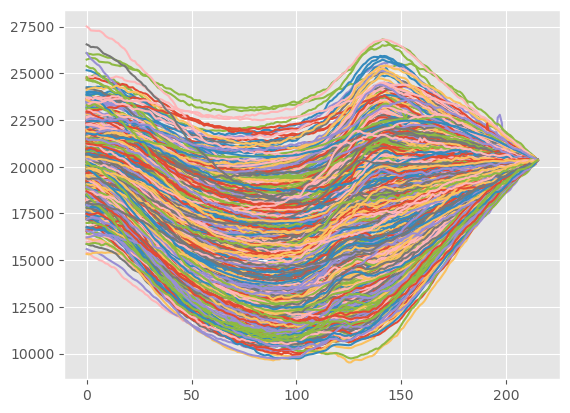

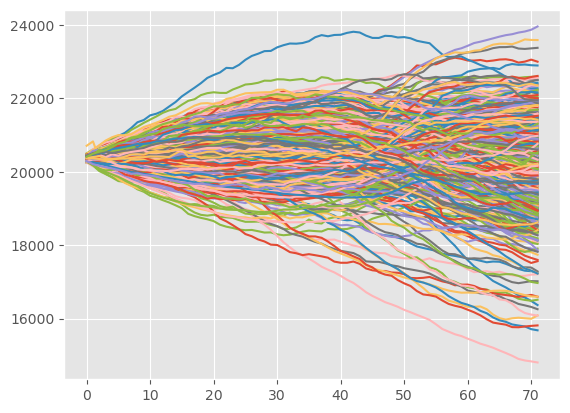

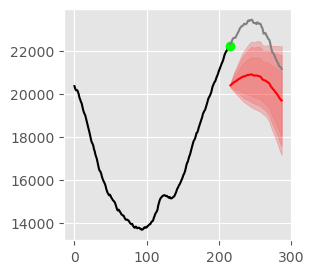

0 0
(657, 216) (657, 216)


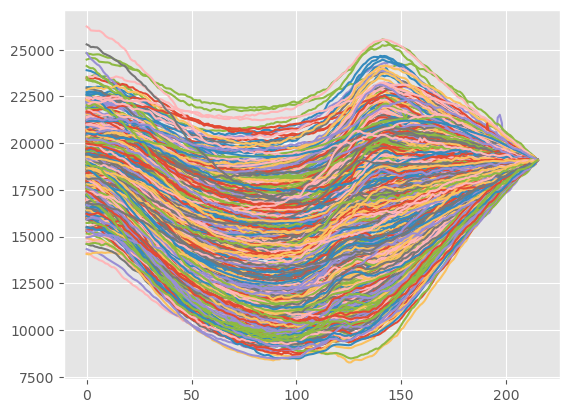

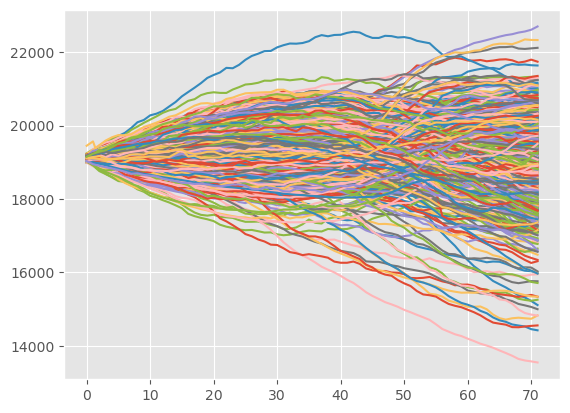

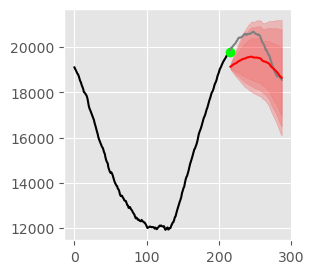

0 0
(657, 216) (657, 216)


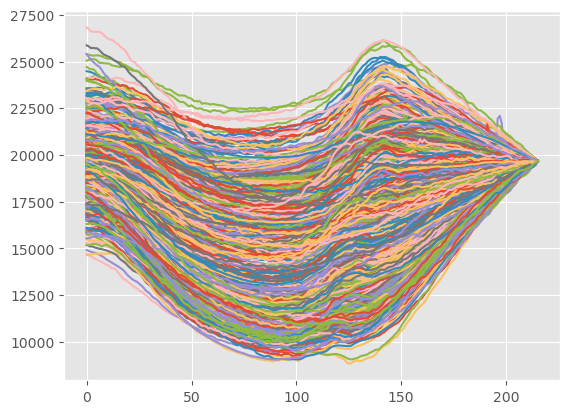

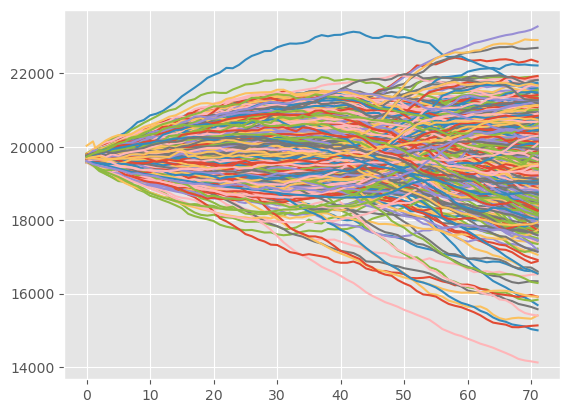

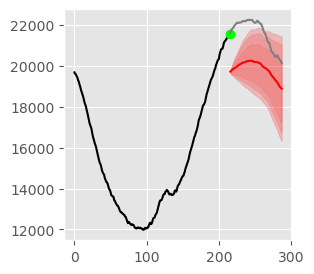

0 0
(657, 216) (657, 216)


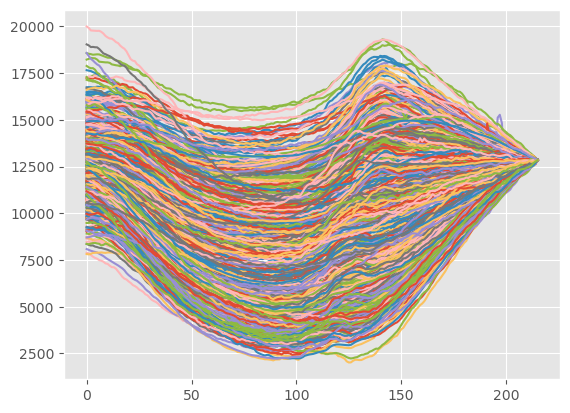

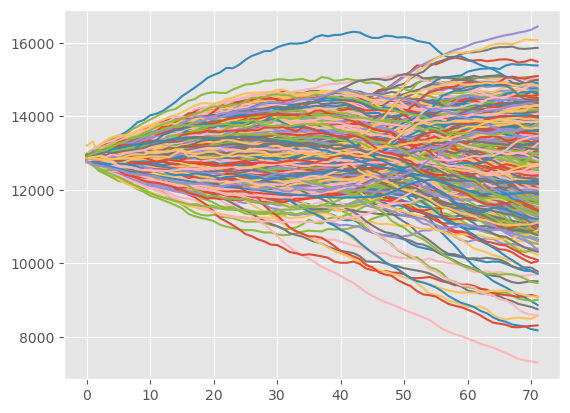

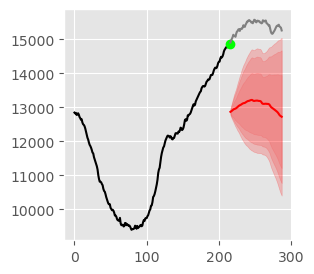

0 0
(657, 216) (657, 216)


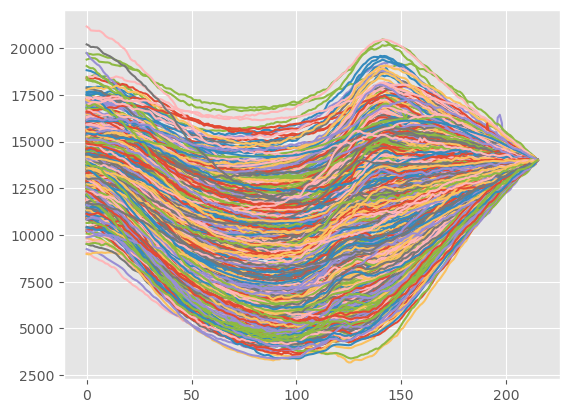

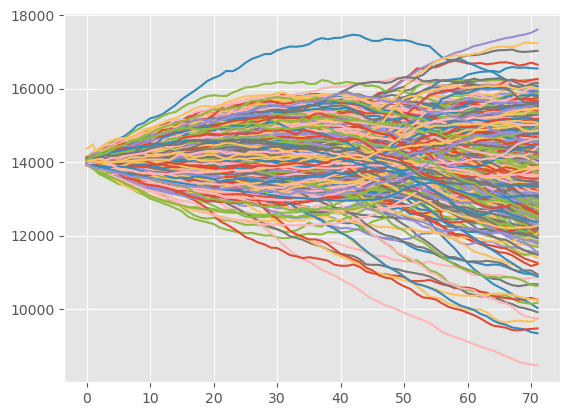

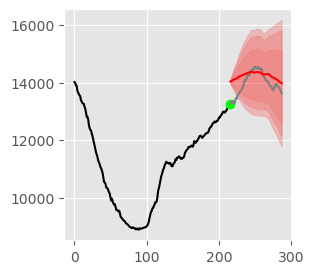

0 0
(657, 216) (657, 216)


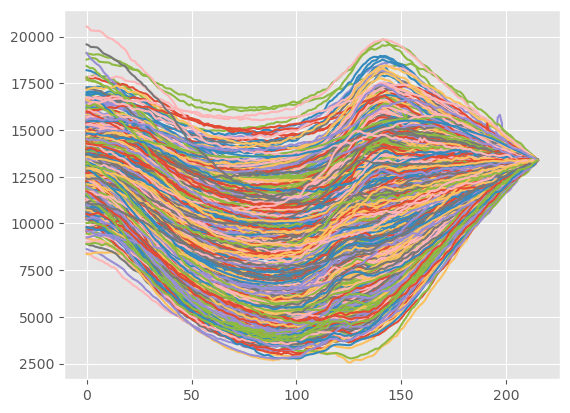

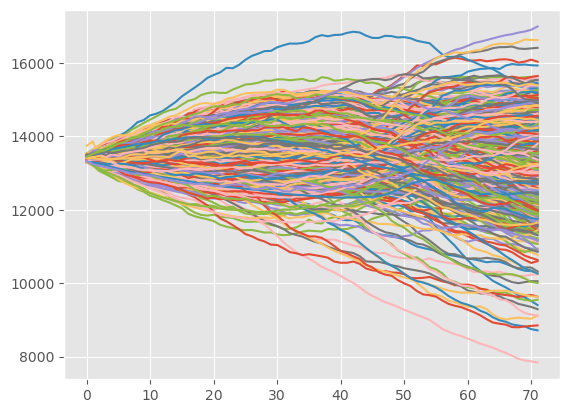

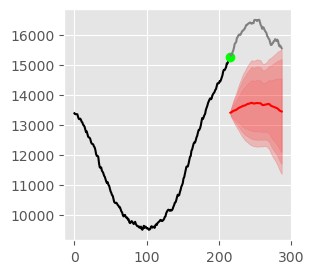

0 0
(657, 216) (657, 216)


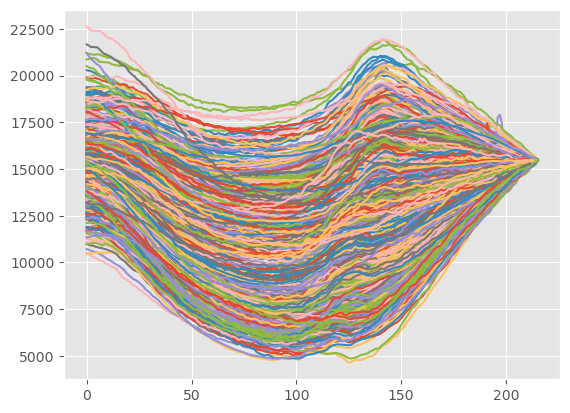

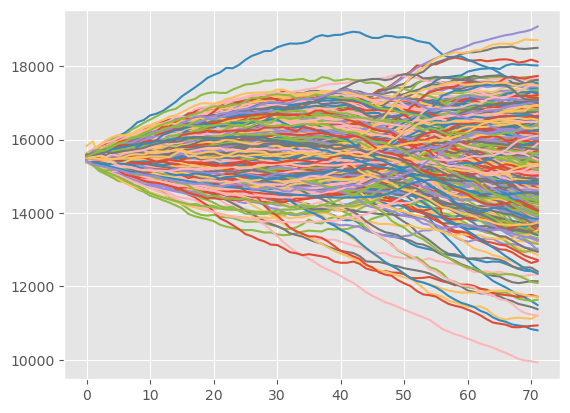

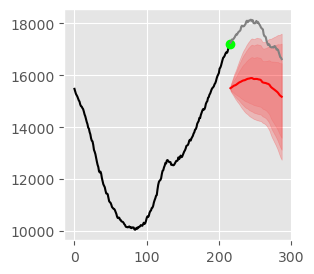

0 0
(657, 216) (657, 216)


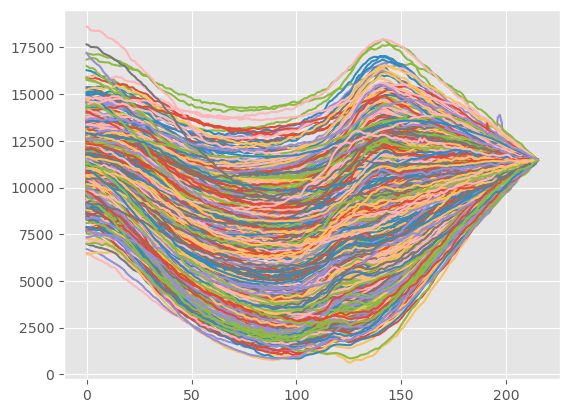

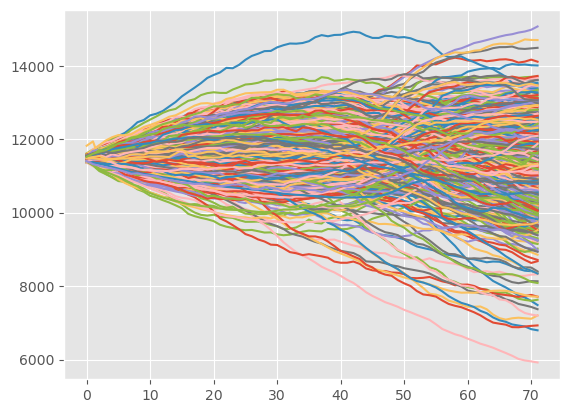

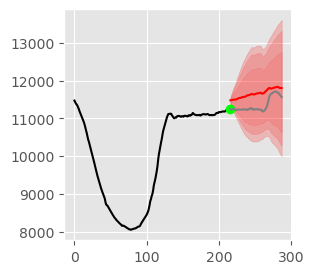

0 0
(657, 216) (657, 216)


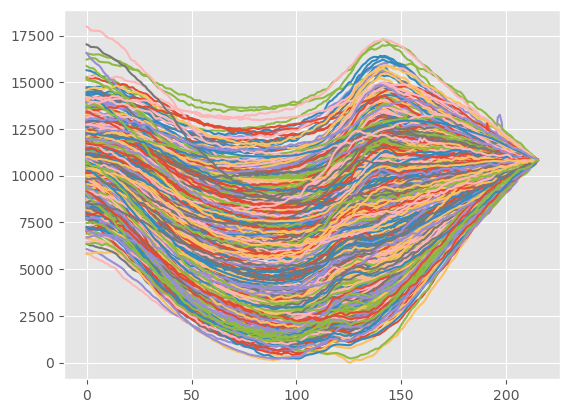

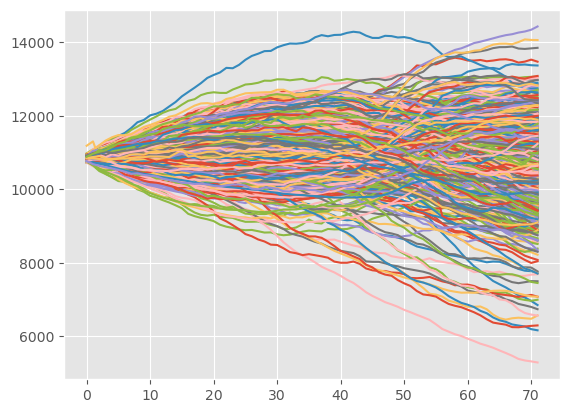

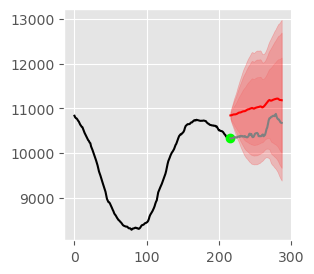

0 0
(657, 216) (657, 216)


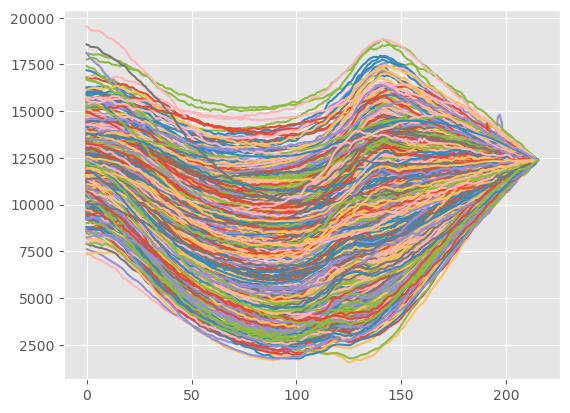

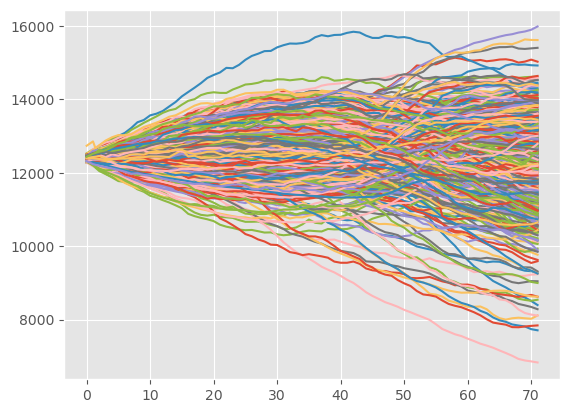

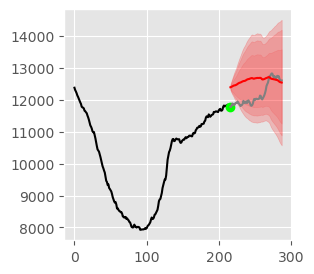

0 0
(657, 216) (657, 216)


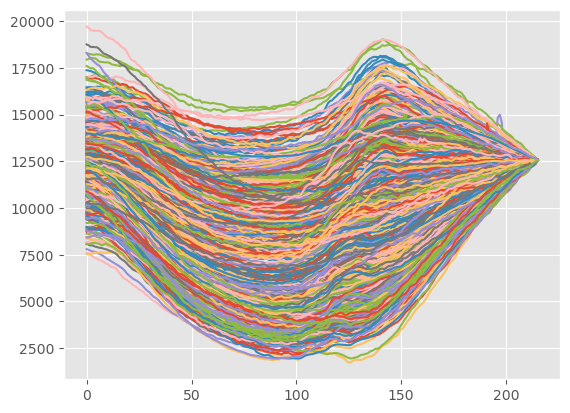

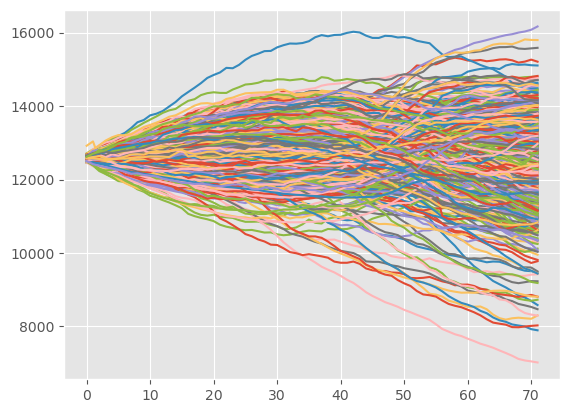

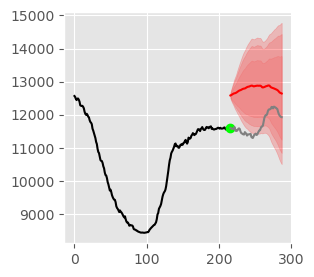

0 0
(657, 216) (657, 216)


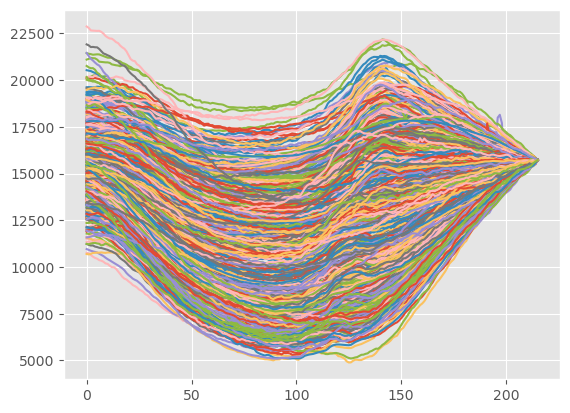

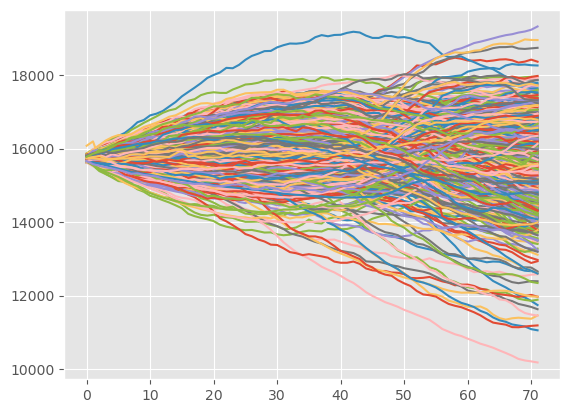

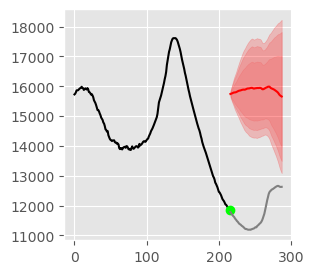

0 0
(657, 216) (657, 216)


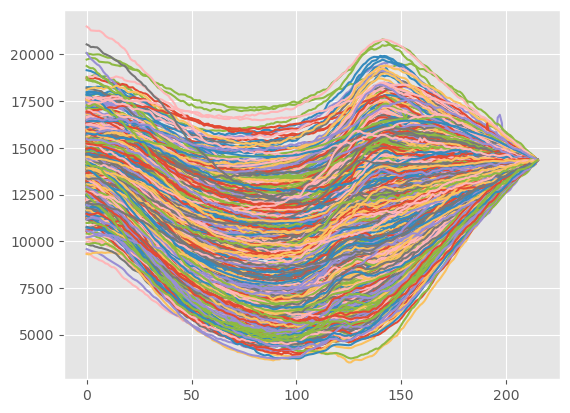

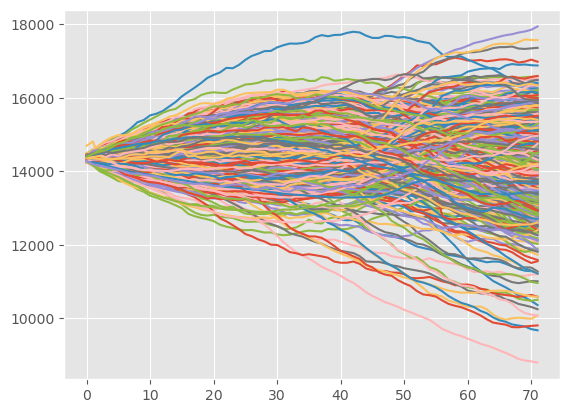

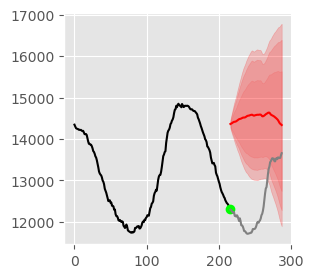

0 0
(657, 216) (657, 216)


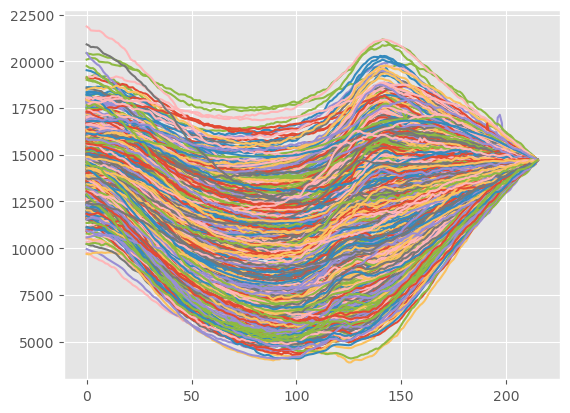

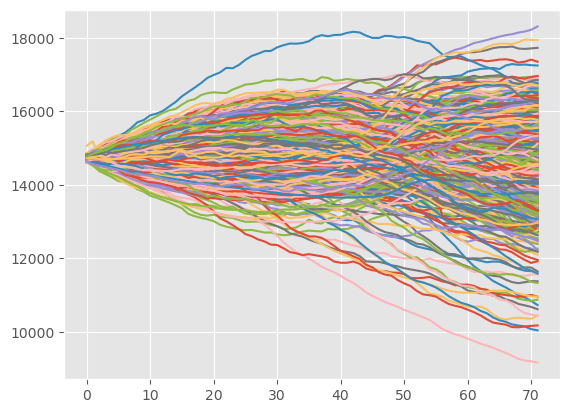

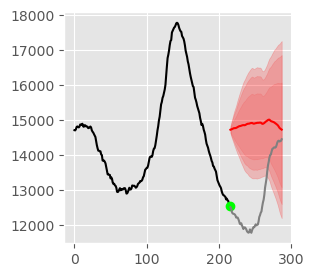

0 0
(657, 216) (657, 216)


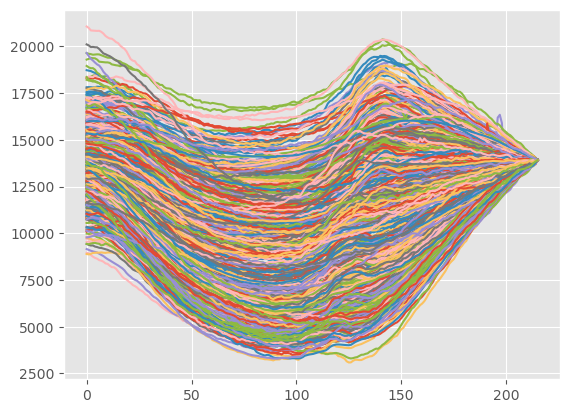

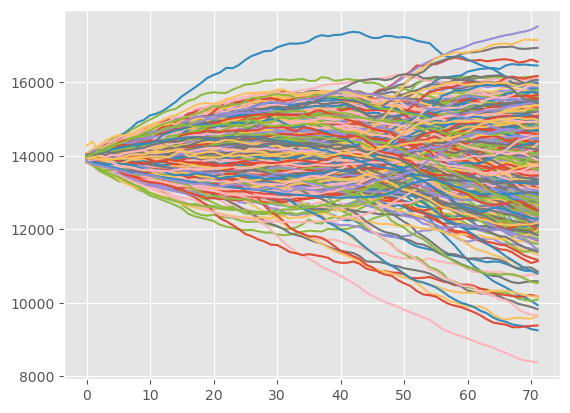

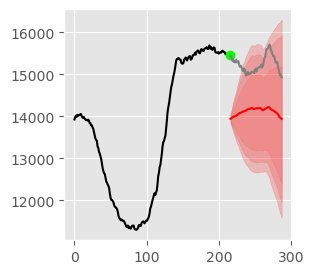

0 0
(657, 216) (657, 216)


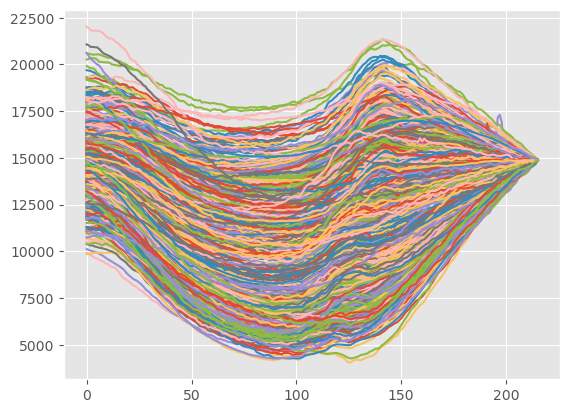

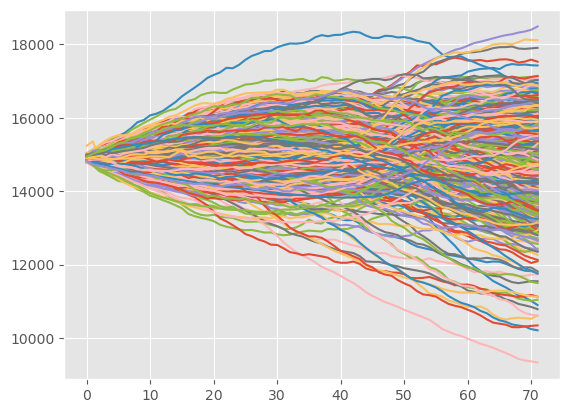

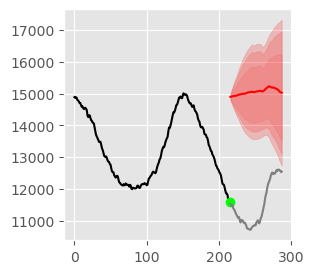

In [406]:
from scipy.spatial.distance import euclidean
from scipy.stats import norm
 
def _exp_dist(X_, x_, theta = 1.):
    N_samples = X_.shape[0]
    d_ = np.zeros((N_samples, 1))
    for i in range(N_samples):
        d_[i] = np.exp( - theta*euclidean(X_[i, :], x_))
    N = int(d_.sum())
    return d_/d_.sum(), N

def _dist(X_, x_):
    N_samples = X_.shape[0]
    d_ = np.zeros((N_samples, 1))
    for i in range(N_samples):
        d_[i] = 1./euclidean(X_[i, :], x_)
    N = int(d_.sum())
    return d_/d_.sum(), N

def _weighted_mean(X_, w_):
    return X_.T @ w_

def _weighted_std(X_, mu_, w_):
    N_samples, N_horizons = X_.shape
    s2_ = np.zeros((N_horizons))
    for i in range(N_horizons):
        s2_[i] = np.sqrt(w_.T @ (X_[:, i] - mu_[i])**2)
    return s2_

def _RMSE(x_, y_):
    return np.sqrt(np.mean((x_ - y_)**2))

def _MAE(x_, y_):
    return np.mean(np.absolute(x_ - y_))

def _CRPS(x_, mu_, s2_):
    s_ = np.sqrt(s2_)
    _N = norm(0, 1)
    a_ = (x_ - mu_)/s_
    return np.mean(s_*(1/np.sqrt(np.pi) - 2.*_N.pdf(a_) - a_*(2.*_N.cdf(a_) - 1.)))

N_tr_days_ = idx_tr_.shape[0]
N_ts_days_ = idx_ts_.shape[0]

nu = 0.5

rmse_ = np.zeros((N_ts_days_, 3))
mae_  = np.zeros((N_ts_days_, 3))
crps_ = np.zeros((N_ts_days_, 3))
for i in range(N_ts_days_):
    
    xi_ts_    = Xi_ts_[i, :]
    y_obs_ts_ = Y_obs_ts_[i, :]
    y_ac_ts_  = Y_ac_ts_[i, :]

    #print(i, Xi_tr_.shape, xi_ts_.shape, Y_tr_.shape, y_ts_.shape)
    b_ = y_obs_ts_[0] - Y_obs_tr_[:, -1]

    Y_obs_tr_p_ = np.stack([Y_obs_tr_[i, :] + b_[i] for i in range(b_.shape[0])])
    Y_ac_tr_p_  = np.stack([Y_ac_tr_[i, :] + b_[i] for i in range(b_.shape[0])])
    
    w_, N_w       = _dist( Y_obs_tr_p_,  y_obs_ts_)
    beta_, N_beta = _dist(Xi_tr_, xi_ts_)
    print(N_w, N_beta)
    


    print(Y_obs_tr_p_.shape, Y_obs_tr_.shape)
    plt.figure()
    plt.plot(Y_obs_tr_p_.T)
    plt.show()
    
    plt.figure()
    plt.plot(Y_ac_tr_p_.T)
    plt.show()
    
    #pi_   = (1. - nu)*w_ + nu*beta_
    #pi_ /= pi_.sum()
    #print(w_.shape, fw_.shape)

    m_w_hat_     = _weighted_mean(Y_ac_tr_p_, w_)[:, 0]
    m_beta_hat_  = _weighted_mean(Y_ac_tr_p_, beta_)[:, 0]
    #m_pi_hat_    = _weighted_mean(Y_ac_tr_p_, pi_)[:, 0]
    
    s2_w_hat_    = _weighted_std(Y_ac_tr_p_, m_w_hat_, w_)
    s2_beta_hat_ = _weighted_std(Y_ac_tr_p_, m_beta_hat_, beta_)
    #s2_pi_hat_   = _weighted_std(Y_ac_tr_, m_pi_hat_, pi_)
    
    b = y_ac_ts_[-1] - m_w_hat_[0]
    
    plt.figure(figsize = (10, 3))
    plt.subplot(131)
    plt.plot(x_obs_, y_obs_ts_, 'k', label = 'f (obs)')
    plt.plot(x_obs_[-1], y_obs_ts_[-1], 'o', color = 'lime', label = 'event (fc)')
    plt.plot(x_ac_, y_ac_ts_, 'gray', label = 'f (ac)')

    # plt.plot(x_ac_, m_w_hat_, label = 'y (fc)', color = 'b')
    # plt.fill_between(x_ac_, m_w_hat_ - 1.28*s2_w_hat_, m_w_hat_ + 1.04*s2_w_hat_, label = '70%', color = 'b', alpha = .1)
    # plt.fill_between(x_ac_, m_w_hat_ - 1.65*s2_w_hat_, m_w_hat_ + 1.65*s2_w_hat_, label = '90%', color = 'b', alpha = .15)
    # plt.fill_between(x_ac_, m_w_hat_ - 1.96*s2_w_hat_, m_w_hat_ + 1.96*s2_w_hat_, label = '95%', color = 'b', alpha = .2)
    
    plt.plot(x_ac_, m_beta_hat_, label = 'y (fc)', color = 'r')
    plt.fill_between(x_ac_, m_beta_hat_ - 1.28*s2_beta_hat_, m_beta_hat_ + 1.04*s2_beta_hat_, label = '70%', color = 'r', alpha = .1)
    plt.fill_between(x_ac_, m_beta_hat_ - 1.65*s2_beta_hat_, m_beta_hat_ + 1.65*s2_beta_hat_, label = '90%', color = 'r', alpha = .15)
    plt.fill_between(x_ac_, m_beta_hat_ - 1.96*s2_beta_hat_, m_beta_hat_ + 1.96*s2_beta_hat_, label = '95%', color = 'r', alpha = .2)
    plt.show()
    
#     rmse_[i, 0] = _RMSE(y_ac_ts_, m_w_hat_)
#     rmse_[i, 1] = _RMSE(y_ac_ts_, m_beta_hat_)
#     rmse_[i, 2] = _RMSE(y_ac_ts_, m_pi_hat_)
    
#     mae_[i, 0] = _MAE(y_ac_ts_, m_w_hat_)
#     mae_[i, 1] = _MAE(y_ac_ts_, m_beta_hat_)
#     mae_[i, 2] = _MAE(y_ac_ts_, m_pi_hat_)

#     crps_[i, 0] = _CRPS(y_ac_ts_, m_w_hat_, s2_w_hat_)
#     crps_[i, 1] = _CRPS(y_ac_ts_, m_beta_hat_, s2_beta_hat_)
#     crps_[i, 2] = _CRPS(y_ac_ts_, m_pi_hat_, s2_pi_hat_)
    
#     plt.figure(figsize = (10, 3))
#     plt.subplot(131)
#     plt.plot(x_obs_, y_obs_ts_, 'k', label = 'f (obs)')
#     plt.plot(x_obs_[-1], y_obs_ts_[-1], 'o', color = 'lime', label = 'event (fc)')

#     plt.plot(x_ac_, m_w_hat_, label = 'y (fc)', color = 'b')
#     plt.fill_between(x_ac_, m_w_hat_ - 1.28*s2_w_hat_, m_w_hat_ + 1.04*s2_w_hat_, label = '70%', color = 'b', alpha = .1)
#     plt.fill_between(x_ac_, m_w_hat_ - 1.65*s2_w_hat_, m_w_hat_ + 1.65*s2_w_hat_, label = '90%', color = 'b', alpha = .15)
#     plt.fill_between(x_ac_, m_w_hat_ - 1.96*s2_w_hat_, m_w_hat_ + 1.96*s2_w_hat_, label = '95%', color = 'b', alpha = .2)

#     plt.plot(x_ac_, y_ac_ts_, 'gray', label = 'f (ac)')

#     plt.subplot(132)
#     plt.plot(x_obs_, y_obs_ts_, 'k', label = 'f (obs)')
#     plt.plot(x_obs_[-1], y_obs_ts_[-1], 'o', color = 'lime', label = 'event (fc)')
#     plt.plot(x_ac_, m_beta_hat_, label = 'y (fc)', color = 'r')

#     plt.fill_between(x_ac_, m_beta_hat_ - 1.28*s2_beta_hat_, m_beta_hat_ + 1.04*s2_beta_hat_, label = '70%', color = 'r', alpha = .1)
#     plt.fill_between(x_ac_, m_beta_hat_ - 1.65*s2_beta_hat_, m_beta_hat_ + 1.65*s2_beta_hat_, label = '90%', color = 'r', alpha = .15)
#     plt.fill_between(x_ac_, m_beta_hat_ - 1.96*s2_beta_hat_, m_beta_hat_ + 1.96*s2_beta_hat_, label = '95%', color = 'r', alpha = .2)
    
#     plt.plot(x_ac_, y_ac_ts_, 'gray', label = 'f (ac)')

#     plt.subplot(133)
#     plt.plot(x_obs_, y_obs_ts_, 'k', label = 'f (obs)')
#     plt.plot(x_obs_[-1], y_obs_ts_[-1], 'o', color = 'lime', label = 'event (fc)')
#     plt.plot(x_ac_, m_pi_hat_, label = 'y (fc)', color = 'g')

#     plt.fill_between(x_ac_, m_pi_hat_ - 1.28*s2_pi_hat_, m_pi_hat_ + 1.04*s2_pi_hat_, label = '70%', color = 'g', alpha = .1)
#     plt.fill_between(x_ac_, m_pi_hat_ - 1.65*s2_pi_hat_, m_pi_hat_ + 1.65*s2_pi_hat_, label = '90%', color = 'g', alpha = .15)
#     plt.fill_between(x_ac_, m_pi_hat_ - 1.96*s2_pi_hat_, m_pi_hat_ + 1.96*s2_pi_hat_, label = '95%', color = 'g', alpha = .2)
    
#     plt.plot(x_ac_, y_ac_ts_, 'gray', label = 'f (ac)')
#     #plt.legend()
#     plt.show()

# plt.figure(figsize = (15, 5))
# plt.subplot(131)
# plt.violinplot(rmse_, [1, 2, 3], showmeans = True, showmedians = True)
# plt.subplot(132)
# plt.violinplot(mae_, [1, 2, 3], showmeans = True, showmedians = True)
# plt.subplot(133)
# plt.violinplot(crps_, [1, 2, 3], showmeans = True, showmedians = True)
# plt.show()

# print(np.mean(rmse_, axis = 0), np.median(rmse_, axis = 0))
# print(np.mean(mae_, axis = 0), np.median(mae_, axis = 0))
# print(np.mean(crps_, axis = 0), np.median(crps_, axis = 0))